## Preprocessing Global TOA Data

Preprocessing global TOA data for historical and ssp585 simulations.

In [1]:
#imports
from matplotlib import pyplot as plt
from matplotlib.lines import Line2D 
from scipy import stats
import cftime
import numpy as np
import pandas as pd
import xarray as xr
import zarr
import gcsfs
import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature

In [2]:
df = pd.read_csv('https://storage.googleapis.com/cmip6/cmip6-zarr-consolidated-stores.csv')
df.head()

,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year,version
0,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,ps,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706
1,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,rsds,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706
2,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,rlus,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706
3,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,rlds,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706
4,HighResMIP,CMCC,CMCC-CM2-HR4,highresSST-present,r1i1p1f1,Amon,psl,gn,gs://cmip6/CMIP6/HighResMIP/CMCC/CMCC-CM2-HR4/...,NaN,20170706


In [3]:
gcs = gcsfs.GCSFileSystem(token='anon')

In [4]:
def load_zarr_dset(df):
  # get the path to a specific zarr store (the first one from the dataframe above)
  zstore = df.zstore.values[-1]

  # create a mutable-mapping-style interface to the store
  mapper = gcs.get_mapper(zstore)

  # open it using xarray and zarr
  ds = xr.open_zarr(mapper, consolidated=True)
  return ds

In [5]:
#time index for hist+ssp585
new_time_index_hist_ssp = pd.date_range('1850-01-01', '2099-12-31', freq = 'ME')
new_time_index_hist_ssp

DatetimeIndex(['1850-01-31', '1850-02-28', '1850-03-31', '1850-04-30',
               '1850-05-31', '1850-06-30', '1850-07-31', '1850-08-31',
               '1850-09-30', '1850-10-31',
               ...
               '2099-03-31', '2099-04-30', '2099-05-31', '2099-06-30',
               '2099-07-31', '2099-08-31', '2099-09-30', '2099-10-31',
               '2099-11-30', '2099-12-31'],
              dtype='datetime64[ns]', length=3000, freq='ME')

In [6]:
#time index to assign abrupt4xCO2 model times to
new_time_index_abrupt =pd.date_range('1850-01-01', '1999-12-31', freq='ME')
new_time_index_abrupt 

DatetimeIndex(['1850-01-31', '1850-02-28', '1850-03-31', '1850-04-30',
               '1850-05-31', '1850-06-30', '1850-07-31', '1850-08-31',
               '1850-09-30', '1850-10-31',
               ...
               '1999-03-31', '1999-04-30', '1999-05-31', '1999-06-30',
               '1999-07-31', '1999-08-31', '1999-09-30', '1999-10-31',
               '1999-11-30', '1999-12-31'],
              dtype='datetime64[ns]', length=1800, freq='ME')

In [7]:
#rlut
df_hist_toa_rlut = df.query(  "activity_id=='CMIP'         & table_id == 'Amon' & variable_id == 'rlut' & experiment_id=='historical'")
df_ssp585_toa_rlut = df.query("activity_id=='ScenarioMIP'  & table_id == 'Amon' & variable_id == 'rlut' & experiment_id=='ssp585'")
#rsut
df_hist_toa_rsut = df.query(  "activity_id=='CMIP'         & table_id == 'Amon' & variable_id == 'rsut' & experiment_id=='historical'")
df_ssp585_toa_rsut = df.query("activity_id=='ScenarioMIP'  & table_id == 'Amon' & variable_id == 'rsut' & experiment_id=='ssp585'")
#rsdt
df_hist_toa_rsdt = df.query(  "activity_id=='CMIP'         & table_id == 'Amon' & variable_id == 'rsdt' & experiment_id=='historical'")
df_ssp585_toa_rsdt = df.query("activity_id=='ScenarioMIP'  & table_id == 'Amon' & variable_id == 'rsdt' & experiment_id=='ssp585'")
#models
models_toa_hist_rlut  =set(df_hist_toa_rlut.source_id)
models_toa_hist_rsut  =set(df_hist_toa_rsut.source_id)
models_toa_hist_rsdt  =set(df_hist_toa_rsdt.source_id) # all models that have toa in the historical simulations
models_toa_ssp585_rlut=set(df_ssp585_toa_rlut.source_id) #all models that have toa in the ssp585 simulations
models_toa_ssp585_rsut=set(df_ssp585_toa_rsut.source_id)
models_toa_ssp585_rsdt=set(df_ssp585_toa_rsdt.source_id)

#intersection of all of the models that have all radiation types
source_set_toa = set.intersection(models_toa_hist_rlut, models_toa_hist_rsut, models_toa_hist_rsdt, models_toa_ssp585_rlut, models_toa_ssp585_rsut, models_toa_ssp585_rsdt)
source_list_toa = list(source_set_toa)
print(len(source_list_toa))

41


In [8]:
#rlut
df_hist_toa_rlut = df.query(  "activity_id=='CMIP'         & table_id == 'Amon' & variable_id == 'rlut' & experiment_id=='historical' & member_id == 'r1i1p1f1'")
df_ssp585_toa_rlut = df.query("activity_id=='ScenarioMIP'  & table_id == 'Amon' & variable_id == 'rlut' & experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
#rsut
df_hist_toa_rsut = df.query(  "activity_id=='CMIP'         & table_id == 'Amon' & variable_id == 'rsut' & experiment_id=='historical' & member_id == 'r1i1p1f1'")
df_ssp585_toa_rsut = df.query("activity_id=='ScenarioMIP'  & table_id == 'Amon' & variable_id == 'rsut' & experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
#rsdt
df_hist_toa_rsdt = df.query(  "activity_id=='CMIP'         & table_id == 'Amon' & variable_id == 'rsdt' & experiment_id=='historical' & member_id == 'r1i1p1f1'")
df_ssp585_toa_rsdt = df.query("activity_id=='ScenarioMIP'  & table_id == 'Amon' & variable_id == 'rsdt' & experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
#models
models_toa_hist_rlut  =set(df_hist_toa_rlut.source_id)
models_toa_hist_rsut  =set(df_hist_toa_rsut.source_id)
models_toa_hist_rsdt  =set(df_hist_toa_rsdt.source_id) # all models that have toa in the historical simulations
models_toa_ssp585_rlut=set(df_ssp585_toa_rlut.source_id) #all models that have toa in the ssp585 simulations
models_toa_ssp585_rsut=set(df_ssp585_toa_rsut.source_id)
models_toa_ssp585_rsdt=set(df_ssp585_toa_rsdt.source_id)

#intersection of all of the models that have all radiation types
source_set_toa_2 = set.intersection(models_toa_hist_rlut, models_toa_hist_rsut, models_toa_hist_rsdt, models_toa_ssp585_rlut, models_toa_ssp585_rsut, models_toa_ssp585_rsdt)
source_list_toa_2 = list(source_set_toa_2)
print(len(source_list_toa_2))

31


In [9]:
#remove models
model_list = ['E3SM-1-1',
               'TaiESM1',
               'CIESM',
              'KIOST-ESM',
               'INM-CM5-0',
               'FGOALS-f3-L',
               'CMCC-CM2-SR5',
               'EC-Earth3-Veg-LR',
               'FIO-ESM-2-0',
               'IITM-ESM',
               'NESM3',
              'MPI-ESM1-2-LR'
             ]

In [10]:
for source in model_list:
    if source in source_list_toa_2:
        source_list_toa_2.remove(source)
print(len(source_list_toa_2))
print(source_list_toa_2)

19
['MPI-ESM1-2-HR', 'KACE-1-0-G', 'ACCESS-CM2', 'CanESM5', 'EC-Earth3', 'INM-CM4-8', 'FGOALS-g3', 'CESM2-WACCM', 'BCC-CSM2-MR', 'NorESM2-MM', 'GFDL-CM4', 'NorESM2-LM', 'MRI-ESM2-0', 'IPSL-CM6A-LR', 'AWI-CM-1-1-MR', 'CAMS-CSM1-0', 'GFDL-ESM4', 'EC-Earth3-Veg', 'MIROC6']


### 1.1 Look at One Model

In [11]:
#query data
#historical data
df_toa_hist_canesm5_rlut = df.query(  "activity_id=='CMIP' & source_id == 'CanESM5' & table_id == 'Amon' & variable_id == 'rlut' & experiment_id=='historical' & member_id == 'r1i1p1f1'")
df_toa_hist_canesm5_rsut = df.query(  "activity_id=='CMIP' & source_id == 'CanESM5' & table_id == 'Amon' & variable_id == 'rsut' & experiment_id=='historical' & member_id == 'r1i1p1f1'")
df_toa_hist_canesm5_rsdt = df.query(  "activity_id=='CMIP' & source_id == 'CanESM5' & table_id == 'Amon' & variable_id == 'rsdt' & experiment_id=='historical' & member_id == 'r1i1p1f1'")
#load hist data as dataset
ds_toa_hist_canesm5_rlut = load_zarr_dset(df_toa_hist_canesm5_rlut)
ds_toa_hist_canesm5_rsut = load_zarr_dset(df_toa_hist_canesm5_rsut)
ds_toa_hist_canesm5_rsdt = load_zarr_dset(df_toa_hist_canesm5_rsdt)
#ssp585 data
df_toa_ssp585_canesm5_rlut = df.query("activity_id=='ScenarioMIP' & source_id == 'CanESM5' & table_id == 'Amon' & variable_id == 'rlut' & experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
df_toa_ssp585_canesm5_rsut = df.query("activity_id=='ScenarioMIP' & source_id == 'CanESM5' & table_id == 'Amon' & variable_id == 'rsut' & experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
df_toa_ssp585_canesm5_rsdt = df.query("activity_id=='ScenarioMIP' & source_id == 'CanESM5' & table_id == 'Amon' & variable_id == 'rsdt' & experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
#load ssp data as dataset
ds_toa_ssp585_canesm5_rlut = load_zarr_dset(df_toa_ssp585_canesm5_rlut)
ds_toa_ssp585_canesm5_rsut = load_zarr_dset(df_toa_ssp585_canesm5_rsut)
ds_toa_ssp585_canesm5_rsdt = load_zarr_dset(df_toa_ssp585_canesm5_rsdt)

ds_hist_toa = ds_toa_hist_canesm5_rsdt.rsdt - ds_toa_hist_canesm5_rsut.rsut - ds_toa_hist_canesm5_rlut.rlut
ds_ssp585_toa = ds_toa_ssp585_canesm5_rsdt.rsdt - ds_toa_ssp585_canesm5_rsut.rsut - ds_toa_ssp585_canesm5_rlut.rlut
ds_toa_canesm5 = xr.concat([ds_hist_toa, ds_ssp585_toa], dim = 'time', coords = 'all', compat = 'override')
ds_toa_canesm5
#weights
weights = np.cos(np.deg2rad(ds_toa_canesm5.lat))
ds_toa_canesm5 = ds_toa_canesm5.weighted(weights).mean(dim=('lon', 'lat'))
#slice to specific period and reassign new time index
ds_toa_canesm5 = ds_toa_canesm5.isel(time=slice(0,3000))
#check ds
ds_toa_canesm5

<xarray.DataArray (time: 3000)>
dask.array<getitem, shape=(3000,), dtype=float64, chunksize=(600,), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) object 1850-01-16 12:00:00 ... 2099-12-16 12:00:00

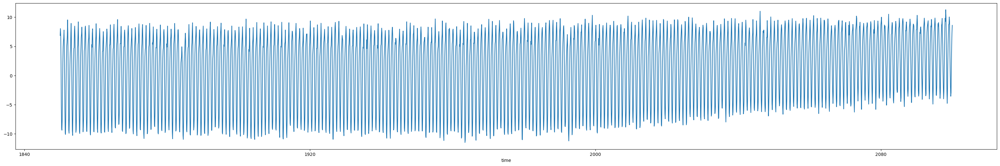

In [12]:
fig, ax = plt.subplots(figsize = (40,6))
ds_toa_canesm5.plot(ax=ax)

### 1.2 Loading Multiple Models

In [14]:
gcm_list = ['MIROC6', 
            'GFDL-ESM4', 
            'AWI-CM-1-1-MR', 
            'MPI-ESM1-2-HR', 
            'CanESM5']

In [15]:
#TOA datarray of 5 GCM
ds_list_toa_gcm = list()
for source in gcm_list:
    #query data
    #historical data
    df_toa_hist_rlut = df.query(  "activity_id=='CMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rlut'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f1'")
    df_toa_hist_rsut = df.query(  "activity_id=='CMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rsut'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f1'")
    df_toa_hist_rsdt = df.query(  "activity_id=='CMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rsdt'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f1'")
    df_toacs_hist_rlutcs = df.query("activity_id=='CMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rlutcs'"
                                    "& experiment_id=='historical' & member_id == 'r1i1p1f1'")
    df_toacs_hist_rsutcs = df.query("activity_id=='CMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rsutcs'"
                                    "& experiment_id=='historical' & member_id == 'r1i1p1f1'")
    
    #load hist data as dataset
    ds_toa_hist_rlut = load_zarr_dset(df_toa_hist_rlut)
    ds_toa_hist_rsut = load_zarr_dset(df_toa_hist_rsut)
    ds_toa_hist_rsdt = load_zarr_dset(df_toa_hist_rsdt)
    ds_toacs_hist_rlutcs = load_zarr_dset(df_toacs_hist_rlutcs)
    ds_toacs_hist_rsutcs = load_zarr_dset(df_toacs_hist_rsutcs)
    
    #ssp585 data
    df_toa_ssp585_rlut = df.query("activity_id=='ScenarioMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rlut'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
    df_toa_ssp585_rsut = df.query("activity_id=='ScenarioMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rsut'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
    df_toa_ssp585_rsdt = df.query("activity_id=='ScenarioMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rsdt'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
    df_toacs_ssp585_rlutcs = df.query("activity_id=='ScenarioMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rlutcs'"
                                      "& experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
    df_toacs_ssp585_rsutcs = df.query("activity_id=='ScenarioMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rsutcs'"
                                      "& experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
    #load ssp data as dataset
    ds_toa_ssp585_rlut = load_zarr_dset(df_toa_ssp585_rlut)
    ds_toa_ssp585_rsut = load_zarr_dset(df_toa_ssp585_rsut)
    ds_toa_ssp585_rsdt = load_zarr_dset(df_toa_ssp585_rsdt)
    ds_toacs_ssp585_rlutcs = load_zarr_dset(df_toacs_ssp585_rlutcs)
    ds_toacs_ssp585_rsutcs = load_zarr_dset(df_toacs_ssp585_rsutcs)

    #toa variable
    ds_hist_toa = ds_toa_hist_rsdt.rsdt - ds_toa_hist_rsut.rsut - ds_toa_hist_rlut.rlut
    ds_ssp585_toa = ds_toa_ssp585_rsdt.rsdt - ds_toa_ssp585_rsut.rsut - ds_toa_ssp585_rlut.rlut
    ds_toa = xr.concat([ds_hist_toa, ds_ssp585_toa], dim = 'time', coords = 'all', compat = 'override')
    
    #toacs and final cre variable
    ds_hist_toacs = ds_toa_hist_rsdt.rsdt - ds_toacs_hist_rlutcs.rlutcs - ds_toacs_hist_rsutcs.rsutcs
    ds_ssp585_toacs = ds_toa_ssp585_rsdt.rsdt - ds_toacs_ssp585_rlutcs.rlutcs - ds_toacs_ssp585_rsutcs.rsutcs
    ds_hist_cre = ds_hist_toa - ds_hist_toacs
    ds_ssp585_cre = ds_ssp585_toa - ds_ssp585_toacs
    ds_cre = xr.concat([ds_hist_cre, ds_ssp585_cre], dim = 'time', coords = 'all', compat = 'override')

    #weights for toa and cre (combine at the end)
    weights_toa = np.cos(np.deg2rad(ds_toa.lat))
    weights_cre = np.cos(np.deg2rad(ds_cre.lat))
    ds_toa = ds_toa.weighted(weights_toa).mean(dim=('lon', 'lat'))
    ds_cre = ds_cre.weighted(weights_cre).mean(dim=('lon', 'lat'))
    
    #combine toa and cre data-arrays
    ds_toa_cre_merged = xr.Dataset({'toa': ds_toa, 'cre': ds_cre})
    
    #slice to specific period and reassign new time index
    ds_toa_cre_merged = ds_toa_cre_merged.isel(time=slice(0,3000))
    ds_toa_cre_merged = ds_toa_cre_merged.assign(time=new_time_index_hist_ssp)
    ds_toa_cre_merged = ds_toa_cre_merged.assign_coords(model=source)
    ds_list_toa_gcm.append(ds_toa_cre_merged)

#check ds
ds_toa_gcm_models = xr.concat(ds_list_toa_gcm, dim = 'model', coords = 'minimal', compat = 'override')
ds_toa_gcm_models

<xarray.Dataset>
Dimensions:  (time: 3000, model: 5)
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
  * model    (model) <U13 'MIROC6' 'GFDL-ESM4' ... 'MPI-ESM1-2-HR' 'CanESM5'
Data variables:
    toa      (model, time) float64 dask.array<chunksize=(1, 201), meta=np.ndarray>
    cre      (model, time) float64 dask.array<chunksize=(1, 201), meta=np.ndarray>

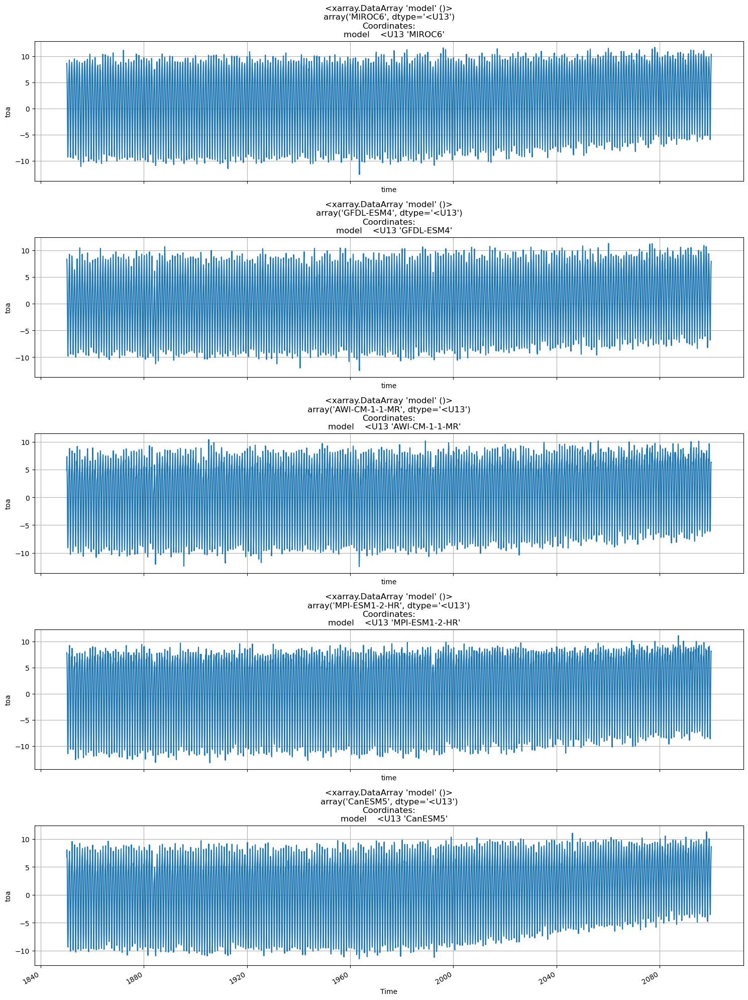

In [16]:
#TOA PLOTS
fig, axs = plt.subplots(5, 1, figsize=(15, 20), sharex=True)
for i, model in enumerate(ds_toa_gcm_models.model):
    ds_toa_gcm_models.sel(model=model).toa.plot(ax=axs[i], label=model) #selects each model and the tas variable, plots over each axes
    axs[i].set_title(model) #shows what model number
    axs[i].set_ylabel('toa')
    axs[i].grid(True)
axs[-1].set_xlabel('Time') 
plt.tight_layout()
plt.show()

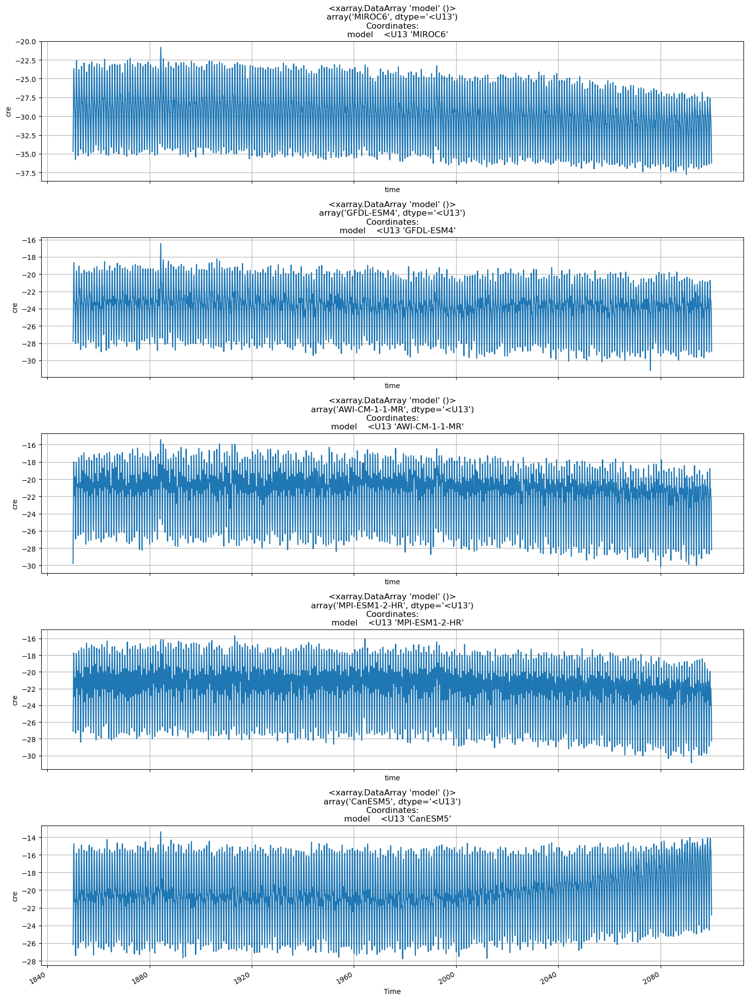

In [28]:
#CRE PLOTS
fig, axs = plt.subplots(5, 1, figsize=(15, 20), sharex=True)
for i, model in enumerate(ds_toa_gcm_models.model): #enumerate returns iterator of pairs, each pair contains the index and the corresponding element from the iterable
    ds_toa_gcm_models.sel(model=model).cre.plot(ax=axs[i], label=model) #selects each model and the tas variable, plots over each axes
    axs[i].set_title(model) #shows what model number
    axs[i].set_ylabel('cre')
    axs[i].grid(True) #makes gridlines on plot
axs[-1].set_xlabel('Time') 
plt.tight_layout() #creates a better layout for subplots
plt.show()

#### Adding in More Models

In [36]:
ds_list_8_models = list()
#query data
#historical data
df_toa_hist_rlut = df.query(  "activity_id=='CMIP' & source_id == 'CNRM-CM6-1-HR' & table_id == 'Amon' & variable_id == 'rlut'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toa_hist_rsut = df.query(  "activity_id=='CMIP' & source_id == 'CNRM-CM6-1-HR' & table_id == 'Amon' & variable_id == 'rsut'&"
                            "experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toa_hist_rsdt = df.query(  "activity_id=='CMIP' & source_id == 'CNRM-CM6-1-HR' & table_id == 'Amon' & variable_id == 'rsdt'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toacs_hist_rlutcs = df.query("activity_id=='CMIP' & source_id == 'CNRM-CM6-1-HR' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toacs_hist_rsutcs = df.query("activity_id=='CMIP' & source_id == 'CNRM-CM6-1-HR' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_tas_hist =      df.query(  "activity_id=='CMIP' & source_id == 'CNRM-CM6-1-HR' & table_id == 'Amon' & variable_id == 'tas'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
   
#load hist data as dataset
ds_toa_hist_rlut = load_zarr_dset(df_toa_hist_rlut)
ds_toa_hist_rsut = load_zarr_dset(df_toa_hist_rsut)
ds_toa_hist_rsdt = load_zarr_dset(df_toa_hist_rsdt)
ds_toacs_hist_rlutcs = load_zarr_dset(df_toacs_hist_rlutcs)
ds_toacs_hist_rsutcs = load_zarr_dset(df_toacs_hist_rsutcs)
ds_tas_hist = load_zarr_dset(df_tas_hist)
    
#ssp585 data
df_toa_ssp585_rlut = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-CM6-1-HR' & table_id == 'Amon' & variable_id == 'rlut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toa_ssp585_rsut = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-CM6-1-HR' & table_id == 'Amon' & variable_id == 'rsut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toa_ssp585_rsdt = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-CM6-1-HR' & table_id == 'Amon' & variable_id == 'rsdt'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toacs_ssp585_rlutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-CM6-1-HR' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toacs_ssp585_rsutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-CM6-1-HR' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_tas_ssp585 =      df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-CM6-1-HR' & table_id == 'Amon' & variable_id == 'tas'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")

#load ssp data as dataset
ds_toa_ssp585_rlut = load_zarr_dset(df_toa_ssp585_rlut)
ds_toa_ssp585_rsut = load_zarr_dset(df_toa_ssp585_rsut)
ds_toa_ssp585_rsdt = load_zarr_dset(df_toa_ssp585_rsdt)
ds_toacs_ssp585_rlutcs = load_zarr_dset(df_toacs_ssp585_rlutcs)
ds_toacs_ssp585_rsutcs = load_zarr_dset(df_toacs_ssp585_rsutcs)
ds_tas_ssp585 = load_zarr_dset(df_tas_ssp585)

#toa variable
ds_hist_toa = ds_toa_hist_rsdt.rsdt - ds_toa_hist_rsut.rsut - ds_toa_hist_rlut.rlut
ds_ssp585_toa = ds_toa_ssp585_rsdt.rsdt - ds_toa_ssp585_rsut.rsut - ds_toa_ssp585_rlut.rlut
ds_toa = xr.concat([ds_hist_toa, ds_ssp585_toa], dim = 'time', coords = 'all', compat = 'override')
#tas variable
ds_tas = xr.concat([ds_tas_hist, ds_tas_ssp585], dim = 'time', coords = 'all', compat = 'override')
#toacs and final cre variable
ds_hist_toacs = ds_toa_hist_rsdt.rsdt - ds_toacs_hist_rlutcs.rlutcs - ds_toacs_hist_rsutcs.rsutcs
ds_ssp585_toacs = ds_toa_ssp585_rsdt.rsdt - ds_toacs_ssp585_rlutcs.rlutcs - ds_toacs_ssp585_rsutcs.rsutcs
ds_hist_cre = ds_hist_toa - ds_hist_toacs
ds_ssp585_cre = ds_ssp585_toa - ds_ssp585_toacs
ds_cre = xr.concat([ds_hist_cre, ds_ssp585_cre], dim = 'time', coords = 'all', compat = 'override')

#weights for toa and cre (combine at the end)
weights_toa = np.cos(np.deg2rad(ds_toa.lat))
weights_cre = np.cos(np.deg2rad(ds_cre.lat))
ds_toa = ds_toa.weighted(weights_toa).mean(dim=('lon', 'lat'))
ds_cre = ds_cre.weighted(weights_cre).mean(dim=('lon', 'lat'))
#weights for tas
weights_tas = np.cos(np.deg2rad(ds_tas.tas.lat))
ds_tas = ds_tas.weighted(weights_tas).mean(dim=('lon', 'lat'))
#combine toa and cre data-arrays
ds_toa_cre_merged = xr.Dataset({'toa': ds_toa, 'cre': ds_cre, 'tas':ds_tas.tas})
    
#slice to specific period and reassign new time index
ds_toa_cre_merged = ds_toa_cre_merged.isel(time=slice(0,3000))
ds_toa_cre_merged = ds_toa_cre_merged.assign(time=new_time_index_hist_ssp)
ds_toa_cre_merged = ds_toa_cre_merged.assign_coords(model=ds_toa_hist_rlut.source_id)
ds_list_8_models.append(ds_toa_cre_merged)
print(ds_toa_cre_merged)

<xarray.Dataset>
Dimensions:  (time: 3000)
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
    height   (time) float64 2.0 2.0 2.0 2.0 2.0 2.0 ... 2.0 2.0 2.0 2.0 2.0 2.0
    model    <U13 'CNRM-CM6-1-HR'
Data variables:
    toa      (time) float64 dask.array<chunksize=(76,), meta=np.ndarray>
    cre      (time) float64 dask.array<chunksize=(76,), meta=np.ndarray>
    tas      (time) float64 dask.array<chunksize=(96,), meta=np.ndarray>


In [37]:
#query data
#historical data
df_toa_hist_rlut = df.query(  "activity_id=='CMIP' & source_id == 'MIROC-ES2L' & table_id == 'Amon' & variable_id == 'rlut'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toa_hist_rsut = df.query(  "activity_id=='CMIP' & source_id == 'MIROC-ES2L' & table_id == 'Amon' & variable_id == 'rsut'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toa_hist_rsdt = df.query(  "activity_id=='CMIP' & source_id == 'MIROC-ES2L' & table_id == 'Amon' & variable_id == 'rsdt'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toacs_hist_rlutcs = df.query("activity_id=='CMIP' & source_id == 'MIROC-ES2L' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toacs_hist_rsutcs = df.query("activity_id=='CMIP' & source_id == 'MIROC-ES2L' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_tas_hist =      df.query(  "activity_id=='CMIP' & source_id == 'MIROC-ES2L' & table_id == 'Amon' & variable_id == 'tas'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
   
#load hist data as dataset
ds_toa_hist_rlut = load_zarr_dset(df_toa_hist_rlut)
ds_toa_hist_rsut = load_zarr_dset(df_toa_hist_rsut)
ds_toa_hist_rsdt = load_zarr_dset(df_toa_hist_rsdt)
ds_toacs_hist_rlutcs = load_zarr_dset(df_toacs_hist_rlutcs)
ds_toacs_hist_rsutcs = load_zarr_dset(df_toacs_hist_rsutcs)
ds_tas_hist = load_zarr_dset(df_tas_hist)
    
#ssp585 data
df_toa_ssp585_rlut = df.query("activity_id=='ScenarioMIP' & source_id == 'MIROC-ES2L' & table_id == 'Amon' & variable_id == 'rlut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toa_ssp585_rsut = df.query("activity_id=='ScenarioMIP' & source_id == 'MIROC-ES2L' & table_id == 'Amon' & variable_id == 'rsut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toa_ssp585_rsdt = df.query("activity_id=='ScenarioMIP' & source_id == 'MIROC-ES2L' & table_id == 'Amon' & variable_id == 'rsdt'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toacs_ssp585_rlutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'MIROC-ES2L' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toacs_ssp585_rsutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'MIROC-ES2L' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_tas_ssp585 =      df.query("activity_id=='ScenarioMIP' & source_id == 'MIROC-ES2L' & table_id == 'Amon' & variable_id == 'tas'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")

#load ssp data as dataset
ds_toa_ssp585_rlut = load_zarr_dset(df_toa_ssp585_rlut)
ds_toa_ssp585_rsut = load_zarr_dset(df_toa_ssp585_rsut)
ds_toa_ssp585_rsdt = load_zarr_dset(df_toa_ssp585_rsdt)
ds_toacs_ssp585_rlutcs = load_zarr_dset(df_toacs_ssp585_rlutcs)
ds_toacs_ssp585_rsutcs = load_zarr_dset(df_toacs_ssp585_rsutcs)
ds_tas_ssp585 = load_zarr_dset(df_tas_ssp585)

#toa variable
ds_hist_toa = ds_toa_hist_rsdt.rsdt - ds_toa_hist_rsut.rsut - ds_toa_hist_rlut.rlut
ds_ssp585_toa = ds_toa_ssp585_rsdt.rsdt - ds_toa_ssp585_rsut.rsut - ds_toa_ssp585_rlut.rlut
ds_toa = xr.concat([ds_hist_toa, ds_ssp585_toa], dim = 'time', coords = 'all', compat = 'override')
#tas variable
ds_tas = xr.concat([ds_tas_hist, ds_tas_ssp585], dim = 'time', coords = 'all', compat = 'override')
#toacs and final cre variable
ds_hist_toacs = ds_toa_hist_rsdt.rsdt - ds_toacs_hist_rlutcs.rlutcs - ds_toacs_hist_rsutcs.rsutcs
ds_ssp585_toacs = ds_toa_ssp585_rsdt.rsdt - ds_toacs_ssp585_rlutcs.rlutcs - ds_toacs_ssp585_rsutcs.rsutcs
ds_hist_cre = ds_hist_toa - ds_hist_toacs
ds_ssp585_cre = ds_ssp585_toa - ds_ssp585_toacs
ds_cre = xr.concat([ds_hist_cre, ds_ssp585_cre], dim = 'time', coords = 'all', compat = 'override')

#weights for toa and cre (combine at the end)
weights_toa = np.cos(np.deg2rad(ds_toa.lat))
weights_cre = np.cos(np.deg2rad(ds_cre.lat))
ds_toa = ds_toa.weighted(weights_toa).mean(dim=('lon', 'lat'))
ds_cre = ds_cre.weighted(weights_cre).mean(dim=('lon', 'lat'))
#weights for tas
weights_tas = np.cos(np.deg2rad(ds_tas.tas.lat))
ds_tas = ds_tas.weighted(weights_tas).mean(dim=('lon', 'lat'))
#combine toa and cre data-arrays
ds_toa_cre_merged = xr.Dataset({'toa': ds_toa, 'cre': ds_cre, 'tas':ds_tas.tas})
    
#slice to specific period and reassign new time index
ds_toa_cre_merged = ds_toa_cre_merged.isel(time=slice(0,3000))
ds_toa_cre_merged = ds_toa_cre_merged.assign(time=new_time_index_hist_ssp)
ds_toa_cre_merged = ds_toa_cre_merged.assign_coords(model=ds_toa_hist_rlut.source_id)
ds_list_8_models.append(ds_toa_cre_merged)
print(ds_toa_cre_merged)

<xarray.Dataset>
Dimensions:  (time: 3000)
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
    height   (time) float64 2.0 2.0 2.0 2.0 2.0 2.0 ... 2.0 2.0 2.0 2.0 2.0 2.0
    model    <U10 'MIROC-ES2L'
Data variables:
    toa      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>
    cre      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>
    tas      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>


In [38]:
#query data
#historical data
df_toa_hist_rlut = df.query(  "activity_id=='CMIP' & source_id == 'CNRM-ESM2-1' & table_id == 'Amon' & variable_id == 'rlut'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toa_hist_rsut = df.query(  "activity_id=='CMIP' & source_id == 'CNRM-ESM2-1' & table_id == 'Amon' & variable_id == 'rsut'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toa_hist_rsdt = df.query(  "activity_id=='CMIP' & source_id == 'CNRM-ESM2-1' & table_id == 'Amon' & variable_id == 'rsdt'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toacs_hist_rlutcs = df.query("activity_id=='CMIP' & source_id == 'CNRM-ESM2-1' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toacs_hist_rsutcs = df.query("activity_id=='CMIP' & source_id == 'CNRM-ESM2-1' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_tas_hist =      df.query(  "activity_id=='CMIP' & source_id == 'CNRM-ESM2-1' & table_id == 'Amon' & variable_id == 'tas'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
   
#load hist data as dataset
ds_toa_hist_rlut = load_zarr_dset(df_toa_hist_rlut)
ds_toa_hist_rsut = load_zarr_dset(df_toa_hist_rsut)
ds_toa_hist_rsdt = load_zarr_dset(df_toa_hist_rsdt)
ds_toacs_hist_rlutcs = load_zarr_dset(df_toacs_hist_rlutcs)
ds_toacs_hist_rsutcs = load_zarr_dset(df_toacs_hist_rsutcs)
ds_tas_hist = load_zarr_dset(df_tas_hist)
    
#ssp585 data
df_toa_ssp585_rlut = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-ESM2-1' & table_id == 'Amon' & variable_id == 'rlut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toa_ssp585_rsut = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-ESM2-1' & table_id == 'Amon' & variable_id == 'rsut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toa_ssp585_rsdt = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-ESM2-1' & table_id == 'Amon' & variable_id == 'rsdt'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toacs_ssp585_rlutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-ESM2-1' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toacs_ssp585_rsutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-ESM2-1' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_tas_ssp585 =      df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-ESM2-1' & table_id == 'Amon' & variable_id == 'tas'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")

#load ssp data as dataset
ds_toa_ssp585_rlut = load_zarr_dset(df_toa_ssp585_rlut)
ds_toa_ssp585_rsut = load_zarr_dset(df_toa_ssp585_rsut)
ds_toa_ssp585_rsdt = load_zarr_dset(df_toa_ssp585_rsdt)
ds_toacs_ssp585_rlutcs = load_zarr_dset(df_toacs_ssp585_rlutcs)
ds_toacs_ssp585_rsutcs = load_zarr_dset(df_toacs_ssp585_rsutcs)
ds_tas_ssp585 = load_zarr_dset(df_tas_ssp585)

#toa variable
ds_hist_toa = ds_toa_hist_rsdt.rsdt - ds_toa_hist_rsut.rsut - ds_toa_hist_rlut.rlut
ds_ssp585_toa = ds_toa_ssp585_rsdt.rsdt - ds_toa_ssp585_rsut.rsut - ds_toa_ssp585_rlut.rlut
ds_toa = xr.concat([ds_hist_toa, ds_ssp585_toa], dim = 'time', coords = 'all', compat = 'override')
#tas variable
ds_tas = xr.concat([ds_tas_hist, ds_tas_ssp585], dim = 'time', coords = 'all', compat = 'override')
#toacs and final cre variable
ds_hist_toacs = ds_toa_hist_rsdt.rsdt - ds_toacs_hist_rlutcs.rlutcs - ds_toacs_hist_rsutcs.rsutcs
ds_ssp585_toacs = ds_toa_ssp585_rsdt.rsdt - ds_toacs_ssp585_rlutcs.rlutcs - ds_toacs_ssp585_rsutcs.rsutcs
ds_hist_cre = ds_hist_toa - ds_hist_toacs
ds_ssp585_cre = ds_ssp585_toa - ds_ssp585_toacs
ds_cre = xr.concat([ds_hist_cre, ds_ssp585_cre], dim = 'time', coords = 'all', compat = 'override')

#weights for toa and cre (combine at the end)
weights_toa = np.cos(np.deg2rad(ds_toa.lat))
weights_cre = np.cos(np.deg2rad(ds_cre.lat))
ds_toa = ds_toa.weighted(weights_toa).mean(dim=('lon', 'lat'))
ds_cre = ds_cre.weighted(weights_cre).mean(dim=('lon', 'lat'))
#weights for tas
weights_tas = np.cos(np.deg2rad(ds_tas.tas.lat))
ds_tas = ds_tas.weighted(weights_tas).mean(dim=('lon', 'lat'))
#combine toa and cre data-arrays
ds_toa_cre_merged = xr.Dataset({'toa': ds_toa, 'cre': ds_cre, 'tas':ds_tas.tas})
    
#slice to specific period and reassign new time index
ds_toa_cre_merged = ds_toa_cre_merged.isel(time=slice(0,3000))
ds_toa_cre_merged = ds_toa_cre_merged.assign(time=new_time_index_hist_ssp)
ds_toa_cre_merged = ds_toa_cre_merged.assign_coords(model=ds_toa_hist_rlut.source_id)
ds_list_8_models.append(ds_toa_cre_merged)
print(ds_toa_cre_merged)

<xarray.Dataset>
Dimensions:  (time: 3000)
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
    height   (time) float64 2.0 2.0 2.0 2.0 2.0 2.0 ... 2.0 2.0 2.0 2.0 2.0 2.0
    model    <U11 'CNRM-ESM2-1'
Data variables:
    toa      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>
    cre      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>
    tas      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>


In [39]:
#query data
#historical data
df_toa_hist_rlut = df.query(  "activity_id=='CMIP' & source_id == 'UKESM1-0-LL' & table_id == 'Amon' & variable_id == 'rlut'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toa_hist_rsut = df.query(  "activity_id=='CMIP' & source_id == 'UKESM1-0-LL' & table_id == 'Amon' & variable_id == 'rsut'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toa_hist_rsdt = df.query(  "activity_id=='CMIP' & source_id == 'UKESM1-0-LL' & table_id == 'Amon' & variable_id == 'rsdt'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toacs_hist_rlutcs = df.query("activity_id=='CMIP' & source_id == 'UKESM1-0-LL' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toacs_hist_rsutcs = df.query("activity_id=='CMIP' & source_id == 'UKESM1-0-LL' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_tas_hist =      df.query(  "activity_id=='CMIP' & source_id == 'UKESM1-0-LL' & table_id == 'Amon' & variable_id == 'tas'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
   
#load hist data as dataset
ds_toa_hist_rlut = load_zarr_dset(df_toa_hist_rlut)
ds_toa_hist_rsut = load_zarr_dset(df_toa_hist_rsut)
ds_toa_hist_rsdt = load_zarr_dset(df_toa_hist_rsdt)
ds_toacs_hist_rlutcs = load_zarr_dset(df_toacs_hist_rlutcs)
ds_toacs_hist_rsutcs = load_zarr_dset(df_toacs_hist_rsutcs)
ds_tas_hist = load_zarr_dset(df_tas_hist)
    
#ssp585 data
df_toa_ssp585_rlut = df.query("activity_id=='ScenarioMIP' & source_id == 'UKESM1-0-LL' & table_id == 'Amon' & variable_id == 'rlut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toa_ssp585_rsut = df.query("activity_id=='ScenarioMIP' & source_id == 'UKESM1-0-LL' & table_id == 'Amon' & variable_id == 'rsut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toa_ssp585_rsdt = df.query("activity_id=='ScenarioMIP' & source_id == 'UKESM1-0-LL' & table_id == 'Amon' & variable_id == 'rsdt'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toacs_ssp585_rlutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'UKESM1-0-LL' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toacs_ssp585_rsutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'UKESM1-0-LL' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_tas_ssp585 =      df.query("activity_id=='ScenarioMIP' & source_id == 'UKESM1-0-LL' & table_id == 'Amon' & variable_id == 'tas'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")

#load ssp data as dataset
ds_toa_ssp585_rlut = load_zarr_dset(df_toa_ssp585_rlut)
ds_toa_ssp585_rsut = load_zarr_dset(df_toa_ssp585_rsut)
ds_toa_ssp585_rsdt = load_zarr_dset(df_toa_ssp585_rsdt)
ds_toacs_ssp585_rlutcs = load_zarr_dset(df_toacs_ssp585_rlutcs)
ds_toacs_ssp585_rsutcs = load_zarr_dset(df_toacs_ssp585_rsutcs)
ds_tas_ssp585 = load_zarr_dset(df_tas_ssp585)

#toa variable
ds_hist_toa = ds_toa_hist_rsdt.rsdt - ds_toa_hist_rsut.rsut - ds_toa_hist_rlut.rlut
ds_ssp585_toa = ds_toa_ssp585_rsdt.rsdt - ds_toa_ssp585_rsut.rsut - ds_toa_ssp585_rlut.rlut
ds_toa = xr.concat([ds_hist_toa, ds_ssp585_toa], dim = 'time', coords = 'all', compat = 'override')
#tas variable
ds_tas = xr.concat([ds_tas_hist, ds_tas_ssp585], dim = 'time', coords = 'all', compat = 'override')
#toacs and final cre variable
ds_hist_toacs = ds_toa_hist_rsdt.rsdt - ds_toacs_hist_rlutcs.rlutcs - ds_toacs_hist_rsutcs.rsutcs
ds_ssp585_toacs = ds_toa_ssp585_rsdt.rsdt - ds_toacs_ssp585_rlutcs.rlutcs - ds_toacs_ssp585_rsutcs.rsutcs
ds_hist_cre = ds_hist_toa - ds_hist_toacs
ds_ssp585_cre = ds_ssp585_toa - ds_ssp585_toacs
ds_cre = xr.concat([ds_hist_cre, ds_ssp585_cre], dim = 'time', coords = 'all', compat = 'override')

#weights for toa and cre (combine at the end)
weights_toa = np.cos(np.deg2rad(ds_toa.lat))
weights_cre = np.cos(np.deg2rad(ds_cre.lat))
ds_toa = ds_toa.weighted(weights_toa).mean(dim=('lon', 'lat'))
ds_cre = ds_cre.weighted(weights_cre).mean(dim=('lon', 'lat'))
#weights for tas
weights_tas = np.cos(np.deg2rad(ds_tas.tas.lat))
ds_tas = ds_tas.weighted(weights_tas).mean(dim=('lon', 'lat'))
#combine toa and cre data-arrays
ds_toa_cre_merged = xr.Dataset({'toa': ds_toa, 'cre': ds_cre, 'tas':ds_tas.tas})
    
#slice to specific period and reassign new time index
ds_toa_cre_merged = ds_toa_cre_merged.isel(time=slice(0,3000))
ds_toa_cre_merged = ds_toa_cre_merged.assign(time=new_time_index_hist_ssp)
ds_toa_cre_merged = ds_toa_cre_merged.assign_coords(model=ds_toa_hist_rlut.source_id)
ds_list_8_models.append(ds_toa_cre_merged)
print(ds_toa_cre_merged)

<xarray.Dataset>
Dimensions:  (time: 3000)
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
    height   (time) float64 1.5 1.5 1.5 1.5 1.5 1.5 ... 1.5 1.5 1.5 1.5 1.5 1.5
    model    <U11 'UKESM1-0-LL'
Data variables:
    toa      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>
    cre      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>
    tas      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>


In [40]:
#query data
#historical data
df_toa_hist_rlut = df.query(  "activity_id=='CMIP' & source_id == 'CNRM-CM6-1' & table_id == 'Amon' & variable_id == 'rlut'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toa_hist_rsut = df.query(  "activity_id=='CMIP' & source_id == 'CNRM-CM6-1' & table_id == 'Amon' & variable_id == 'rsut'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toa_hist_rsdt = df.query(  "activity_id=='CMIP' & source_id == 'CNRM-CM6-1' & table_id == 'Amon' & variable_id == 'rsdt'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toacs_hist_rlutcs = df.query("activity_id=='CMIP' & source_id == 'CNRM-CM6-1' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_toacs_hist_rsutcs = df.query("activity_id=='CMIP' & source_id == 'CNRM-CM6-1' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
df_tas_hist =      df.query(  "activity_id=='CMIP' & source_id == 'CNRM-CM6-1' & table_id == 'Amon' & variable_id == 'tas'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f2'")
   
#load hist data as dataset
ds_toa_hist_rlut = load_zarr_dset(df_toa_hist_rlut)
ds_toa_hist_rsut = load_zarr_dset(df_toa_hist_rsut)
ds_toa_hist_rsdt = load_zarr_dset(df_toa_hist_rsdt)
ds_toacs_hist_rlutcs = load_zarr_dset(df_toacs_hist_rlutcs)
ds_toacs_hist_rsutcs = load_zarr_dset(df_toacs_hist_rsutcs)
ds_tas_hist = load_zarr_dset(df_tas_hist)
    
#ssp585 data
df_toa_ssp585_rlut = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-CM6-1' & table_id == 'Amon' & variable_id == 'rlut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toa_ssp585_rsut = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-CM6-1' & table_id == 'Amon' & variable_id == 'rsut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toa_ssp585_rsdt = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-CM6-1' & table_id == 'Amon' & variable_id == 'rsdt'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toacs_ssp585_rlutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-CM6-1' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_toacs_ssp585_rsutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-CM6-1' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")
df_tas_ssp585 =      df.query("activity_id=='ScenarioMIP' & source_id == 'CNRM-CM6-1' & table_id == 'Amon' & variable_id == 'tas'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f2'")

#load ssp data as dataset
ds_toa_ssp585_rlut = load_zarr_dset(df_toa_ssp585_rlut)
ds_toa_ssp585_rsut = load_zarr_dset(df_toa_ssp585_rsut)
ds_toa_ssp585_rsdt = load_zarr_dset(df_toa_ssp585_rsdt)
ds_toacs_ssp585_rlutcs = load_zarr_dset(df_toacs_ssp585_rlutcs)
ds_toacs_ssp585_rsutcs = load_zarr_dset(df_toacs_ssp585_rsutcs)
ds_tas_ssp585 = load_zarr_dset(df_tas_ssp585)

#toa variable
ds_hist_toa = ds_toa_hist_rsdt.rsdt - ds_toa_hist_rsut.rsut - ds_toa_hist_rlut.rlut
ds_ssp585_toa = ds_toa_ssp585_rsdt.rsdt - ds_toa_ssp585_rsut.rsut - ds_toa_ssp585_rlut.rlut
ds_toa = xr.concat([ds_hist_toa, ds_ssp585_toa], dim = 'time', coords = 'all', compat = 'override')
#tas variable
ds_tas = xr.concat([ds_tas_hist, ds_tas_ssp585], dim = 'time', coords = 'all', compat = 'override')
#toacs and final cre variable
ds_hist_toacs = ds_toa_hist_rsdt.rsdt - ds_toacs_hist_rlutcs.rlutcs - ds_toacs_hist_rsutcs.rsutcs
ds_ssp585_toacs = ds_toa_ssp585_rsdt.rsdt - ds_toacs_ssp585_rlutcs.rlutcs - ds_toacs_ssp585_rsutcs.rsutcs
ds_hist_cre = ds_hist_toa - ds_hist_toacs
ds_ssp585_cre = ds_ssp585_toa - ds_ssp585_toacs
ds_cre = xr.concat([ds_hist_cre, ds_ssp585_cre], dim = 'time', coords = 'all', compat = 'override')

#weights for toa and cre (combine at the end)
weights_toa = np.cos(np.deg2rad(ds_toa.lat))
weights_cre = np.cos(np.deg2rad(ds_cre.lat))
ds_toa = ds_toa.weighted(weights_toa).mean(dim=('lon', 'lat'))
ds_cre = ds_cre.weighted(weights_cre).mean(dim=('lon', 'lat'))
#weights for tas
weights_tas = np.cos(np.deg2rad(ds_tas.tas.lat))
ds_tas = ds_tas.weighted(weights_tas).mean(dim=('lon', 'lat'))
#combine toa and cre data-arrays
ds_toa_cre_merged = xr.Dataset({'toa': ds_toa, 'cre': ds_cre, 'tas':ds_tas.tas})
    
#slice to specific period and reassign new time index
ds_toa_cre_merged = ds_toa_cre_merged.isel(time=slice(0,3000))
ds_toa_cre_merged = ds_toa_cre_merged.assign(time=new_time_index_hist_ssp)
ds_toa_cre_merged = ds_toa_cre_merged.assign_coords(model=ds_toa_hist_rlut.source_id)
ds_list_8_models.append(ds_toa_cre_merged)
print(ds_toa_cre_merged)

<xarray.Dataset>
Dimensions:  (time: 3000)
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
    height   (time) float64 2.0 2.0 2.0 2.0 2.0 2.0 ... 2.0 2.0 2.0 2.0 2.0 2.0
    model    <U10 'CNRM-CM6-1'
Data variables:
    toa      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>
    cre      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>
    tas      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>


In [41]:
#query data
#historical data
df_toa_hist_rlut = df.query(  "activity_id=='CMIP' & source_id == 'HadGEM3-GC31-LL' & table_id == 'Amon' & variable_id == 'rlut'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f3'")
df_toa_hist_rsut = df.query(  "activity_id=='CMIP' & source_id == 'HadGEM3-GC31-LL' & table_id == 'Amon' & variable_id == 'rsut'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f3'")
df_toa_hist_rsdt = df.query(  "activity_id=='CMIP' & source_id == 'HadGEM3-GC31-LL' & table_id == 'Amon' & variable_id == 'rsdt'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f3'")
df_toacs_hist_rlutcs = df.query("activity_id=='CMIP' & source_id == 'HadGEM3-GC31-LL' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f3'")
df_toacs_hist_rsutcs = df.query("activity_id=='CMIP' & source_id == 'HadGEM3-GC31-LL' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f3'")
df_tas_hist =      df.query(  "activity_id=='CMIP' & source_id == 'HadGEM3-GC31-LL' & table_id == 'Amon' & variable_id == 'tas'"
                            "& experiment_id=='historical' & member_id == 'r1i1p1f3'")
   
#load hist data as dataset
ds_toa_hist_rlut = load_zarr_dset(df_toa_hist_rlut)
ds_toa_hist_rsut = load_zarr_dset(df_toa_hist_rsut)
ds_toa_hist_rsdt = load_zarr_dset(df_toa_hist_rsdt)
ds_toacs_hist_rlutcs = load_zarr_dset(df_toacs_hist_rlutcs)
ds_toacs_hist_rsutcs = load_zarr_dset(df_toacs_hist_rsutcs)
ds_tas_hist = load_zarr_dset(df_tas_hist)
    
#ssp585 data
df_toa_ssp585_rlut = df.query("activity_id=='ScenarioMIP' & source_id == 'HadGEM3-GC31-LL' & table_id == 'Amon' & variable_id == 'rlut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f3'")
df_toa_ssp585_rsut = df.query("activity_id=='ScenarioMIP' & source_id == 'HadGEM3-GC31-LL' & table_id == 'Amon' & variable_id == 'rsut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f3'")
df_toa_ssp585_rsdt = df.query("activity_id=='ScenarioMIP' & source_id == 'HadGEM3-GC31-LL' & table_id == 'Amon' & variable_id == 'rsdt'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f3'")
df_toacs_ssp585_rlutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'HadGEM3-GC31-LL' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f3'")
df_toacs_ssp585_rsutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'HadGEM3-GC31-LL' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f3'")
df_tas_ssp585 =      df.query("activity_id=='ScenarioMIP' & source_id == 'HadGEM3-GC31-LL' & table_id == 'Amon' & variable_id == 'tas'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p1f3'")

#load ssp data as dataset
ds_toa_ssp585_rlut = load_zarr_dset(df_toa_ssp585_rlut)
ds_toa_ssp585_rsut = load_zarr_dset(df_toa_ssp585_rsut)
ds_toa_ssp585_rsdt = load_zarr_dset(df_toa_ssp585_rsdt)
ds_toacs_ssp585_rlutcs = load_zarr_dset(df_toacs_ssp585_rlutcs)
ds_toacs_ssp585_rsutcs = load_zarr_dset(df_toacs_ssp585_rsutcs)
ds_tas_ssp585 = load_zarr_dset(df_tas_ssp585)

#toa variable
ds_hist_toa = ds_toa_hist_rsdt.rsdt - ds_toa_hist_rsut.rsut - ds_toa_hist_rlut.rlut
ds_ssp585_toa = ds_toa_ssp585_rsdt.rsdt - ds_toa_ssp585_rsut.rsut - ds_toa_ssp585_rlut.rlut
ds_toa = xr.concat([ds_hist_toa, ds_ssp585_toa], dim = 'time', coords = 'all', compat = 'override')
#tas variable
ds_tas = xr.concat([ds_tas_hist, ds_tas_ssp585], dim = 'time', coords = 'all', compat = 'override')
#toacs and final cre variable
ds_hist_toacs = ds_toa_hist_rsdt.rsdt - ds_toacs_hist_rlutcs.rlutcs - ds_toacs_hist_rsutcs.rsutcs
ds_ssp585_toacs = ds_toa_ssp585_rsdt.rsdt - ds_toacs_ssp585_rlutcs.rlutcs - ds_toacs_ssp585_rsutcs.rsutcs
ds_hist_cre = ds_hist_toa - ds_hist_toacs
ds_ssp585_cre = ds_ssp585_toa - ds_ssp585_toacs
ds_cre = xr.concat([ds_hist_cre, ds_ssp585_cre], dim = 'time', coords = 'all', compat = 'override')

#weights for toa and cre (combine at the end)
weights_toa = np.cos(np.deg2rad(ds_toa.lat))
weights_cre = np.cos(np.deg2rad(ds_cre.lat))
ds_toa = ds_toa.weighted(weights_toa).mean(dim=('lon', 'lat'))
ds_cre = ds_cre.weighted(weights_cre).mean(dim=('lon', 'lat'))
#weights for tas
weights_tas = np.cos(np.deg2rad(ds_tas.tas.lat))
ds_tas = ds_tas.weighted(weights_tas).mean(dim=('lon', 'lat'))
#combine toa and cre data-arrays
ds_toa_cre_merged = xr.Dataset({'toa': ds_toa, 'cre': ds_cre, 'tas':ds_tas.tas})
    
#slice to specific period and reassign new time index
ds_toa_cre_merged = ds_toa_cre_merged.isel(time=slice(0,3000))
ds_toa_cre_merged = ds_toa_cre_merged.assign(time=new_time_index_hist_ssp)
ds_toa_cre_merged = ds_toa_cre_merged.assign_coords(model=ds_toa_hist_rlut.source_id)
ds_list_8_models.append(ds_toa_cre_merged)
print(ds_toa_cre_merged)

<xarray.Dataset>
Dimensions:  (time: 3000)
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
    height   (time) float64 1.5 1.5 1.5 1.5 1.5 1.5 ... 1.5 1.5 1.5 1.5 1.5 1.5
    model    <U15 'HadGEM3-GC31-LL'
Data variables:
    toa      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>
    cre      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>
    tas      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>


In [42]:
#query data
#historical data
df_toa_hist_rlut = df.query(  "activity_id=='CMIP' & source_id == 'CanESM5-CanOE' & table_id == 'Amon' & variable_id == 'rlut'"
                            "& experiment_id=='historical' & member_id == 'r1i1p2f1'")
df_toa_hist_rsut = df.query(  "activity_id=='CMIP' & source_id == 'CanESM5-CanOE' & table_id == 'Amon' & variable_id == 'rsut'"
                            "& experiment_id=='historical' & member_id == 'r1i1p2f1'")
df_toa_hist_rsdt = df.query(  "activity_id=='CMIP' & source_id == 'CanESM5-CanOE' & table_id == 'Amon' & variable_id == 'rsdt'"
                            "& experiment_id=='historical' & member_id == 'r1i1p2f1'")
df_toacs_hist_rlutcs = df.query("activity_id=='CMIP' & source_id == 'CanESM5-CanOE' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p2f1'")
df_toacs_hist_rsutcs = df.query("activity_id=='CMIP' & source_id == 'CanESM5-CanOE' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                "& experiment_id=='historical' & member_id == 'r1i1p2f1'")
df_tas_hist =      df.query(  "activity_id=='CMIP' & source_id == 'CanESM5-CanOE' & table_id == 'Amon' & variable_id == 'tas'"
                            "& experiment_id=='historical' & member_id == 'r1i1p2f1'")
   
#load hist data as dataset
ds_toa_hist_rlut = load_zarr_dset(df_toa_hist_rlut)
ds_toa_hist_rsut = load_zarr_dset(df_toa_hist_rsut)
ds_toa_hist_rsdt = load_zarr_dset(df_toa_hist_rsdt)
ds_toacs_hist_rlutcs = load_zarr_dset(df_toacs_hist_rlutcs)
ds_toacs_hist_rsutcs = load_zarr_dset(df_toacs_hist_rsutcs)
ds_tas_hist = load_zarr_dset(df_tas_hist)
    
#ssp585 data
df_toa_ssp585_rlut = df.query("activity_id=='ScenarioMIP' & source_id == 'CanESM5-CanOE' & table_id == 'Amon' & variable_id == 'rlut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p2f1'")
df_toa_ssp585_rsut = df.query("activity_id=='ScenarioMIP' & source_id == 'CanESM5-CanOE' & table_id == 'Amon' & variable_id == 'rsut'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p2f1'")
df_toa_ssp585_rsdt = df.query("activity_id=='ScenarioMIP' & source_id == 'CanESM5-CanOE' & table_id == 'Amon' & variable_id == 'rsdt'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p2f1'")
df_toacs_ssp585_rlutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'CanESM5-CanOE' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p2f1'")
df_toacs_ssp585_rsutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'CanESM5-CanOE' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p2f1'")
df_tas_ssp585 =      df.query("activity_id=='ScenarioMIP' & source_id == 'CanESM5-CanOE' & table_id == 'Amon' & variable_id == 'tas'"
                              "& experiment_id=='ssp585' & member_id == 'r1i1p2f1'")

#load ssp data as dataset
ds_toa_ssp585_rlut = load_zarr_dset(df_toa_ssp585_rlut)
ds_toa_ssp585_rsut = load_zarr_dset(df_toa_ssp585_rsut)
ds_toa_ssp585_rsdt = load_zarr_dset(df_toa_ssp585_rsdt)
ds_toacs_ssp585_rlutcs = load_zarr_dset(df_toacs_ssp585_rlutcs)
ds_toacs_ssp585_rsutcs = load_zarr_dset(df_toacs_ssp585_rsutcs)
ds_tas_ssp585 = load_zarr_dset(df_tas_ssp585)

#toa variable
ds_hist_toa = ds_toa_hist_rsdt.rsdt - ds_toa_hist_rsut.rsut - ds_toa_hist_rlut.rlut
ds_ssp585_toa = ds_toa_ssp585_rsdt.rsdt - ds_toa_ssp585_rsut.rsut - ds_toa_ssp585_rlut.rlut
ds_toa = xr.concat([ds_hist_toa, ds_ssp585_toa], dim = 'time', coords = 'all', compat = 'override')
#tas variable
ds_tas = xr.concat([ds_tas_hist, ds_tas_ssp585], dim = 'time', coords = 'all', compat = 'override')
#toacs and final cre variable
ds_hist_toacs = ds_toa_hist_rsdt.rsdt - ds_toacs_hist_rlutcs.rlutcs - ds_toacs_hist_rsutcs.rsutcs
ds_ssp585_toacs = ds_toa_ssp585_rsdt.rsdt - ds_toacs_ssp585_rlutcs.rlutcs - ds_toacs_ssp585_rsutcs.rsutcs
ds_hist_cre = ds_hist_toa - ds_hist_toacs
ds_ssp585_cre = ds_ssp585_toa - ds_ssp585_toacs
ds_cre = xr.concat([ds_hist_cre, ds_ssp585_cre], dim = 'time', coords = 'all', compat = 'override')

#weights for toa and cre (combine at the end)
weights_toa = np.cos(np.deg2rad(ds_toa.lat))
weights_cre = np.cos(np.deg2rad(ds_cre.lat))
ds_toa = ds_toa.weighted(weights_toa).mean(dim=('lon', 'lat'))
ds_cre = ds_cre.weighted(weights_cre).mean(dim=('lon', 'lat'))
#weights for tas
weights_tas = np.cos(np.deg2rad(ds_tas.tas.lat))
ds_tas = ds_tas.weighted(weights_tas).mean(dim=('lon', 'lat'))
#combine toa and cre data-arrays
ds_toa_cre_merged = xr.Dataset({'toa': ds_toa, 'cre': ds_cre, 'tas':ds_tas.tas})
    
#slice to specific period and reassign new time index
ds_toa_cre_merged = ds_toa_cre_merged.isel(time=slice(0,3000))
ds_toa_cre_merged = ds_toa_cre_merged.assign(time=new_time_index_hist_ssp)
ds_toa_cre_merged = ds_toa_cre_merged.assign_coords(model=ds_toa_hist_rlut.source_id)
ds_list_8_models.append(ds_toa_cre_merged)
print(ds_toa_cre_merged)

<xarray.Dataset>
Dimensions:  (time: 3000)
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
    height   (time) float64 2.0 2.0 2.0 2.0 2.0 2.0 ... 2.0 2.0 2.0 2.0 2.0 2.0
    model    <U13 'CanESM5-CanOE'
Data variables:
    toa      (time) float64 dask.array<chunksize=(990,), meta=np.ndarray>
    cre      (time) float64 dask.array<chunksize=(990,), meta=np.ndarray>
    tas      (time) float64 dask.array<chunksize=(1887,), meta=np.ndarray>


In [43]:
#query data
#historical data
df_toa_hist_rlut = df.query(  "activity_id=='CMIP' & source_id == 'CESM2' & table_id == 'Amon' & variable_id == 'rlut'"
                            "& experiment_id=='historical' & member_id == 'r10i1p1f1'")
df_toa_hist_rsut = df.query(  "activity_id=='CMIP' & source_id == 'CESM2' & table_id == 'Amon' & variable_id == 'rsut'"
                            "& experiment_id=='historical' & member_id == 'r10i1p1f1'")
df_toa_hist_rsdt = df.query(  "activity_id=='CMIP' & source_id == 'CESM2' & table_id == 'Amon' & variable_id == 'rsdt'"
                            "& experiment_id=='historical' & member_id == 'r10i1p1f1'")
df_toacs_hist_rlutcs = df.query("activity_id=='CMIP' & source_id == 'CESM2' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                "& experiment_id=='historical' & member_id == 'r10i1p1f1'")
df_toacs_hist_rsutcs = df.query("activity_id=='CMIP' & source_id == 'CESM2' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                "& experiment_id=='historical' & member_id == 'r10i1p1f1'")
df_tas_hist =      df.query(  "activity_id=='CMIP' & source_id == 'CESM2' & table_id == 'Amon' & variable_id == 'tas'"
                            "& experiment_id=='historical' & member_id == 'r10i1p1f1'")
   
#load hist data as dataset
ds_toa_hist_rlut = load_zarr_dset(df_toa_hist_rlut)
ds_toa_hist_rsut = load_zarr_dset(df_toa_hist_rsut)
ds_toa_hist_rsdt = load_zarr_dset(df_toa_hist_rsdt)
ds_toacs_hist_rlutcs = load_zarr_dset(df_toacs_hist_rlutcs)
ds_toacs_hist_rsutcs = load_zarr_dset(df_toacs_hist_rsutcs)
ds_tas_hist = load_zarr_dset(df_tas_hist)
    
#ssp585 data
df_toa_ssp585_rlut = df.query("activity_id=='ScenarioMIP' & source_id == 'CESM2' & table_id == 'Amon' & variable_id == 'rlut'"
                              "& experiment_id=='ssp585' & member_id == 'r10i1p1f1'")
df_toa_ssp585_rsut = df.query("activity_id=='ScenarioMIP' & source_id == 'CESM2' & table_id == 'Amon' & variable_id == 'rsut'"
                              "& experiment_id=='ssp585' & member_id == 'r10i1p1f1'")
df_toa_ssp585_rsdt = df.query("activity_id=='ScenarioMIP' & source_id == 'CESM2' & table_id == 'Amon' & variable_id == 'rsdt'"
                              "& experiment_id=='ssp585' & member_id == 'r10i1p1f1'")
df_toacs_ssp585_rlutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'CESM2' & table_id == 'Amon' & variable_id == 'rlutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r10i1p1f1'")
df_toacs_ssp585_rsutcs = df.query("activity_id=='ScenarioMIP' & source_id == 'CESM2' & table_id == 'Amon' & variable_id == 'rsutcs'"
                                  "& experiment_id=='ssp585' & member_id == 'r10i1p1f1'")
df_tas_ssp585 =      df.query("activity_id=='ScenarioMIP' & source_id == 'CESM2' & table_id == 'Amon' & variable_id == 'tas'"
                              "& experiment_id=='ssp585' & member_id == 'r10i1p1f1'")

#load ssp data as dataset
ds_toa_ssp585_rlut = load_zarr_dset(df_toa_ssp585_rlut)
ds_toa_ssp585_rsut = load_zarr_dset(df_toa_ssp585_rsut)
ds_toa_ssp585_rsdt = load_zarr_dset(df_toa_ssp585_rsdt)
ds_toacs_ssp585_rlutcs = load_zarr_dset(df_toacs_ssp585_rlutcs)
ds_toacs_ssp585_rsutcs = load_zarr_dset(df_toacs_ssp585_rsutcs)
ds_tas_ssp585 = load_zarr_dset(df_tas_ssp585)

#toa variable
ds_hist_toa = ds_toa_hist_rsdt.rsdt - ds_toa_hist_rsut.rsut - ds_toa_hist_rlut.rlut
ds_ssp585_toa = ds_toa_ssp585_rsdt.rsdt - ds_toa_ssp585_rsut.rsut - ds_toa_ssp585_rlut.rlut
ds_toa = xr.concat([ds_hist_toa, ds_ssp585_toa], dim = 'time', coords = 'all', compat = 'override')
#tas variable
ds_tas = xr.concat([ds_tas_hist, ds_tas_ssp585], dim = 'time', coords = 'all', compat = 'override')
#toacs and final cre variable
ds_hist_toacs = ds_toa_hist_rsdt.rsdt - ds_toacs_hist_rlutcs.rlutcs - ds_toacs_hist_rsutcs.rsutcs
ds_ssp585_toacs = ds_toa_ssp585_rsdt.rsdt - ds_toacs_ssp585_rlutcs.rlutcs - ds_toacs_ssp585_rsutcs.rsutcs
ds_hist_cre = ds_hist_toa - ds_hist_toacs
ds_ssp585_cre = ds_ssp585_toa - ds_ssp585_toacs
ds_cre = xr.concat([ds_hist_cre, ds_ssp585_cre], dim = 'time', coords = 'all', compat = 'override')

#weights for toa and cre (combine at the end)
weights_toa = np.cos(np.deg2rad(ds_toa.lat))
weights_cre = np.cos(np.deg2rad(ds_cre.lat))
ds_toa = ds_toa.weighted(weights_toa).mean(dim=('lon', 'lat'))
ds_cre = ds_cre.weighted(weights_cre).mean(dim=('lon', 'lat'))
#weights for tas
weights_tas = np.cos(np.deg2rad(ds_tas.tas.lat))
ds_tas = ds_tas.weighted(weights_tas).mean(dim=('lon', 'lat'))
#combine toa and cre data-arrays
ds_toa_cre_merged = xr.Dataset({'toa': ds_toa, 'cre': ds_cre, 'tas':ds_tas.tas})
    
#slice to specific period and reassign new time index
ds_toa_cre_merged = ds_toa_cre_merged.isel(time=slice(0,3000))
ds_toa_cre_merged = ds_toa_cre_merged.assign(time=new_time_index_hist_ssp)
ds_toa_cre_merged = ds_toa_cre_merged.assign_coords(model=ds_toa_hist_rlut.source_id)
ds_list_8_models.append(ds_toa_cre_merged)
print(ds_toa_cre_merged)

<xarray.Dataset>
Dimensions:  (time: 3000)
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
    model    <U5 'CESM2'
Data variables:
    toa      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>
    cre      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>
    tas      (time) float64 dask.array<chunksize=(600,), meta=np.ndarray>


In [44]:
ds_8_models = xr.concat(ds_list_8_models, dim = 'model', coords = 'minimal',compat='override')
ds_8_models

<xarray.Dataset>
Dimensions:  (time: 3000, model: 8)
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
    height   (time) float64 2.0 2.0 2.0 2.0 2.0 2.0 ... 2.0 2.0 2.0 2.0 2.0 2.0
  * model    (model) <U15 'CNRM-CM6-1-HR' 'MIROC-ES2L' ... 'CESM2'
Data variables:
    toa      (model, time) float64 dask.array<chunksize=(1, 76), meta=np.ndarray>
    cre      (model, time) float64 dask.array<chunksize=(1, 76), meta=np.ndarray>
    tas      (model, time) float64 dask.array<chunksize=(1, 96), meta=np.ndarray>

In [47]:
#r1i1p1f1 models
ds_list_toa = list()
for source in source_list_toa_2:
    #query data
    #historical data
    df_toa_hist_rlut = df.query(  "activity_id=='CMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rlut'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f1'")
    df_toa_hist_rsut = df.query(  "activity_id=='CMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rsut'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f1'")
    df_toa_hist_rsdt = df.query(  "activity_id=='CMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rsdt'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f1'")
    df_toacs_hist_rlutcs = df.query("activity_id=='CMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rlutcs'"
                                    "& experiment_id=='historical' & member_id == 'r1i1p1f1'")
    df_toacs_hist_rsutcs = df.query("activity_id=='CMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rsutcs'"
                                    "& experiment_id=='historical' & member_id == 'r1i1p1f1'")
    df_tas_hist      = df.query(  "activity_id=='CMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'tas'"
                                "& experiment_id=='historical' & member_id == 'r1i1p1f1'")
    #load hist data as dataset
    ds_toa_hist_rlut = load_zarr_dset(df_toa_hist_rlut)
    ds_toa_hist_rsut = load_zarr_dset(df_toa_hist_rsut)
    ds_toa_hist_rsdt = load_zarr_dset(df_toa_hist_rsdt)
    ds_toacs_hist_rlutcs = load_zarr_dset(df_toacs_hist_rlutcs)
    ds_toacs_hist_rsutcs = load_zarr_dset(df_toacs_hist_rsutcs)
    ds_tas_hist = load_zarr_dset(df_tas_hist)
    
    #ssp585 data
    df_toa_ssp585_rlut = df.query("activity_id=='ScenarioMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rlut'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
    df_toa_ssp585_rsut = df.query("activity_id=='ScenarioMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rsut'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
    df_toa_ssp585_rsdt = df.query("activity_id=='ScenarioMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rsdt'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
    df_toacs_ssp585_rlutcs = df.query("activity_id=='ScenarioMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rlutcs'"
                                      "& experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
    df_toacs_ssp585_rsutcs = df.query("activity_id=='ScenarioMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'rsutcs'"
                                      "& experiment_id=='ssp585' & member_id == 'r1i1p1f1'")
    df_tas_ssp585      = df.query("activity_id=='ScenarioMIP' & source_id == @source & table_id == 'Amon' & variable_id == 'tas'"
                                  "& experiment_id=='ssp585' & member_id == 'r1i1p1f1'")

    #load ssp data as dataset
    ds_toa_ssp585_rlut = load_zarr_dset(df_toa_ssp585_rlut)
    ds_toa_ssp585_rsut = load_zarr_dset(df_toa_ssp585_rsut)
    ds_toa_ssp585_rsdt = load_zarr_dset(df_toa_ssp585_rsdt)
    ds_toacs_ssp585_rlutcs = load_zarr_dset(df_toacs_ssp585_rlutcs)
    ds_toacs_ssp585_rsutcs = load_zarr_dset(df_toacs_ssp585_rsutcs)
    ds_tas_ssp585 = load_zarr_dset(df_tas_ssp585)
    
    #toa variable
    ds_hist_toa = ds_toa_hist_rsdt.rsdt - ds_toa_hist_rsut.rsut - ds_toa_hist_rlut.rlut
    ds_ssp585_toa = ds_toa_ssp585_rsdt.rsdt - ds_toa_ssp585_rsut.rsut - ds_toa_ssp585_rlut.rlut
    ds_toa = xr.concat([ds_hist_toa, ds_ssp585_toa], dim = 'time', coords = 'all', compat = 'override')
    #tas variable
    ds_tas = xr.concat([ds_tas_hist, ds_tas_ssp585], dim = 'time', coords = 'all', compat = 'override')
    #toacs and final cre variable
    ds_hist_toacs = ds_toa_hist_rsdt.rsdt - ds_toacs_hist_rlutcs.rlutcs - ds_toacs_hist_rsutcs.rsutcs
    ds_ssp585_toacs = ds_toa_ssp585_rsdt.rsdt - ds_toacs_ssp585_rlutcs.rlutcs - ds_toacs_ssp585_rsutcs.rsutcs
    ds_hist_cre = ds_hist_toa - ds_hist_toacs
    ds_ssp585_cre = ds_ssp585_toa - ds_ssp585_toacs
    ds_cre = xr.concat([ds_hist_cre, ds_ssp585_cre], dim = 'time', coords = 'all', compat = 'override')

    #weights for toa and cre (combine at the end)
    weights_toa = np.cos(np.deg2rad(ds_toa.lat))
    weights_cre = np.cos(np.deg2rad(ds_cre.lat))
    ds_toa = ds_toa.weighted(weights_toa).mean(dim=('lon', 'lat'))
    ds_cre = ds_cre.weighted(weights_cre).mean(dim=('lon', 'lat'))
    #weights for tas
    weights_tas = np.cos(np.deg2rad(ds_tas.tas.lat))
    ds_tas = ds_tas.weighted(weights_tas).mean(dim=('lon', 'lat'))
    #combine toa and cre data-arrays and add tas
    ds_toa_cre_merged = xr.Dataset({'toa': ds_toa, 'cre': ds_cre, 'tas':ds_tas.tas})
    
    #slice to specific period and reassign new time index
    ds_toa_cre_merged = ds_toa_cre_merged.isel(time=slice(0,3000))
    ds_toa_cre_merged = ds_toa_cre_merged.assign(time=new_time_index_hist_ssp)
    ds_toa_cre_merged = ds_toa_cre_merged.assign_coords(model=source)
    ds_list_toa.append(ds_toa_cre_merged)

#concat and check ds
ds_toa_models = xr.concat(ds_list_toa, dim = 'model', coords = 'minimal', compat = 'override')
ds_toa_models

C:\Users\panda\miniconda3\envs\temp_var\Lib\site-packages\xarray\coding\times.py:724: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
C:\Users\panda\miniconda3\envs\temp_var\Lib\site-packages\xarray\coding\times.py:724: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  dtype = _decode_cf_datetime_dtype(data, units, calendar, self.use_cftime)
C:\Users\panda\miniconda3\envs\temp_var\Lib\site-packages\xarray\core\indexing.py:557: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using cftime.datetime objects instead, reason: dates out of range
  array = array.get_duck_array()
C:\Users\panda\miniconda3\envs\temp_var\Lib\site-packages\xarray\codin

<xarray.Dataset>
Dimensions:  (time: 3000, model: 19)
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
    height   (time) float64 2.0 2.0 2.0 2.0 2.0 2.0 ... 2.0 2.0 2.0 2.0 2.0 2.0
  * model    (model) <U13 'MPI-ESM1-2-HR' 'KACE-1-0-G' ... 'MIROC6'
Data variables:
    toa      (model, time) float64 dask.array<chunksize=(1, 114), meta=np.ndarray>
    cre      (model, time) float64 dask.array<chunksize=(1, 114), meta=np.ndarray>
    tas      (model, time) float64 dask.array<chunksize=(1, 126), meta=np.ndarray>

In [49]:
ds_all_toa_models = xr.concat([ds_toa_models, ds_8_models], dim = 'model', coords = 'minimal', compat = 'override')
ds_all_toa_models = ds_all_toa_models.drop_vars('height')
ds_all_toa_models

<xarray.Dataset>
Dimensions:  (time: 3000, model: 27)
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
  * model    (model) <U15 'MPI-ESM1-2-HR' 'KACE-1-0-G' ... 'CESM2'
Data variables:
    toa      (model, time) float64 dask.array<chunksize=(1, 76), meta=np.ndarray>
    cre      (model, time) float64 dask.array<chunksize=(1, 76), meta=np.ndarray>
    tas      (model, time) float64 dask.array<chunksize=(1, 96), meta=np.ndarray>

#### Plots for Multiple Models

In [78]:
#general fn for makes these subplots
def plot_time_series(fig_counter_input, num_subplots, model_index, dataset):
    fig, axs = plt.subplots(num_subplots, 1, figsize=(15, 20), sharex=True)
    fig_counter = fig_counter_input
    while fig_counter < (fig_counter_input + num_subplots): #made another while loop to separate the graphs and make it cleaner
        for i, model in enumerate(dataset.model[model_index:]): #sliced from 30th index after last model figure shown in previous cell block (index should be same each time in dataset)
            if fig_counter >= (fig_counter_input + num_subplots):
                break
            dataset.sel(model=model).toa.plot(ax=axs[i],label=model)
            axs[i].set_title(model) #shows what model number
            axs[i].set_ylabel('toa')
            axs[i].grid(True) #makes gridlines on plot
            fig_counter +=1
    axs[-1].set_xlabel('Time') 
    plt.tight_layout() #creates a better layout for subplots
    plt.show()

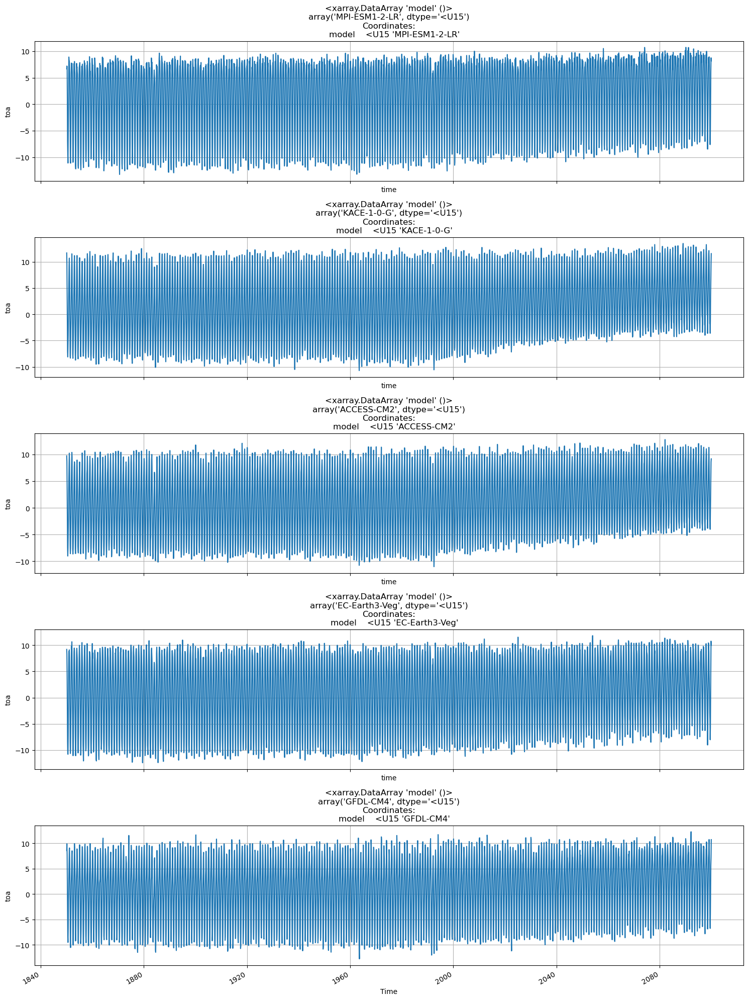

In [79]:
plot_time_series(0,5,0, ds_all_toa_models)

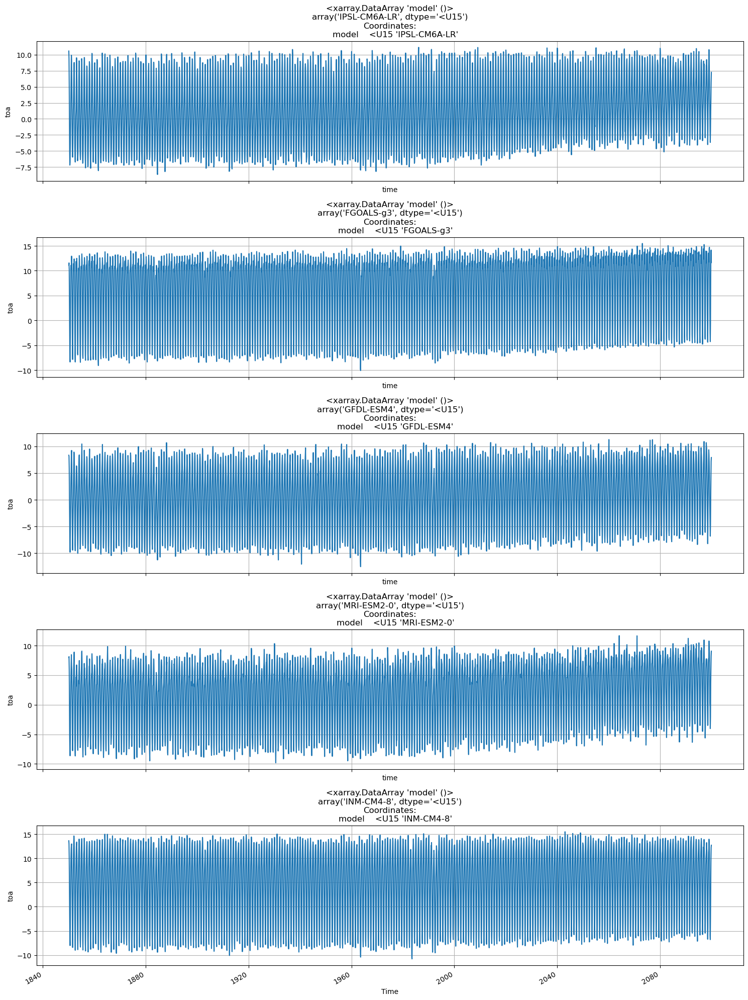

In [80]:
plot_time_series(0,5,5, ds_all_toa_models)

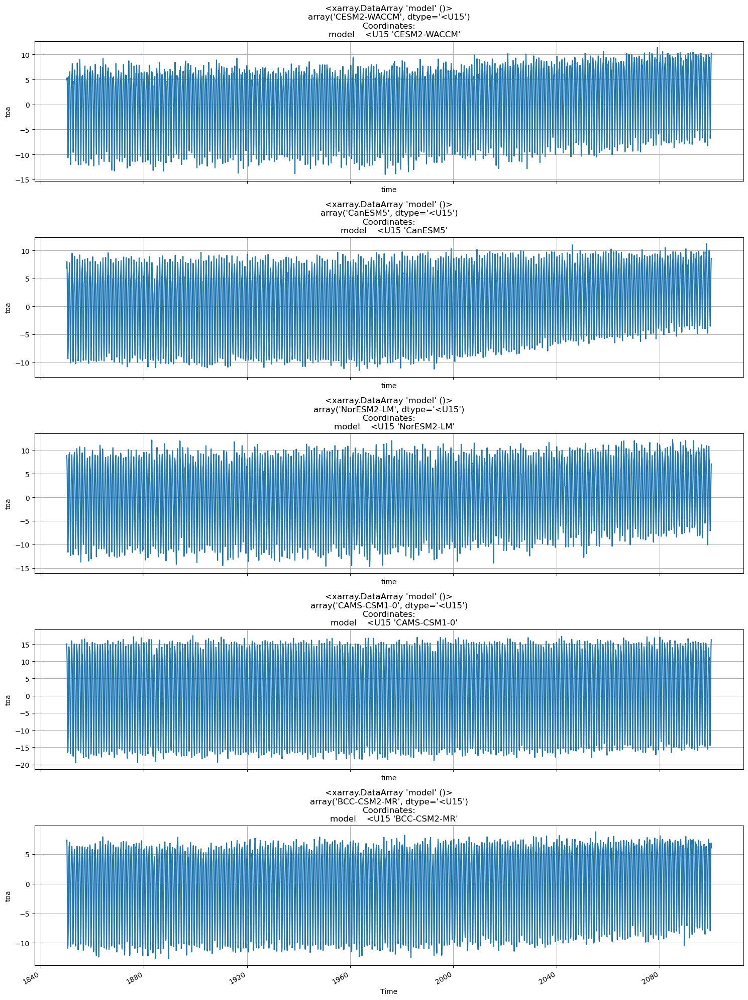

In [81]:
plot_time_series(0,5,10, ds_all_toa_models)

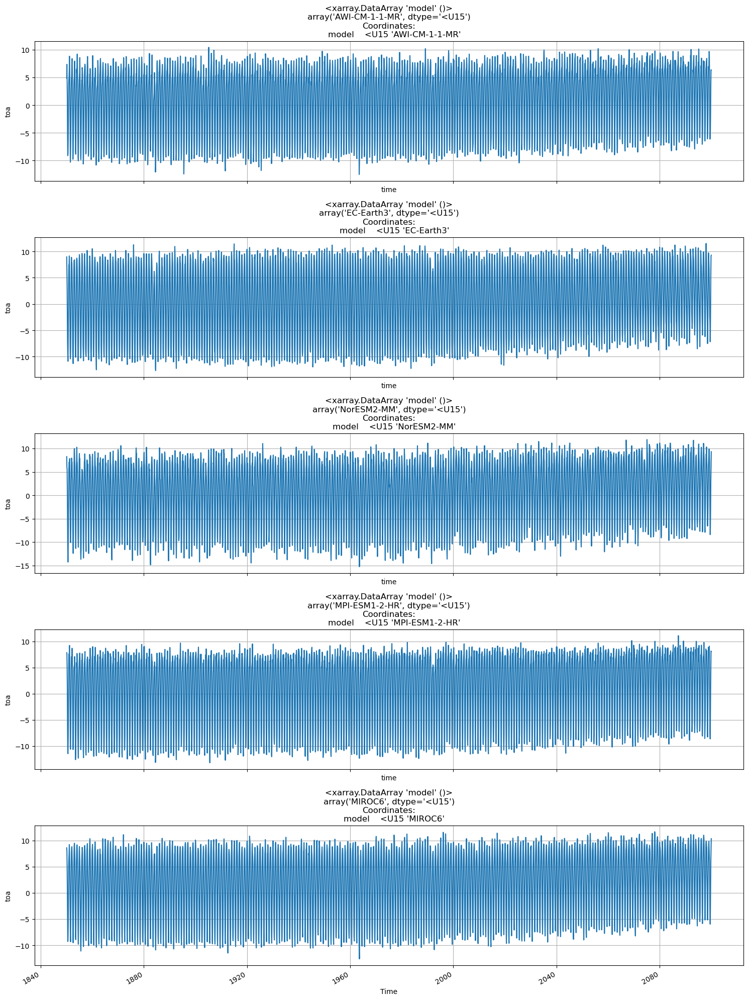

In [82]:
plot_time_series(0,5,15, ds_all_toa_models)

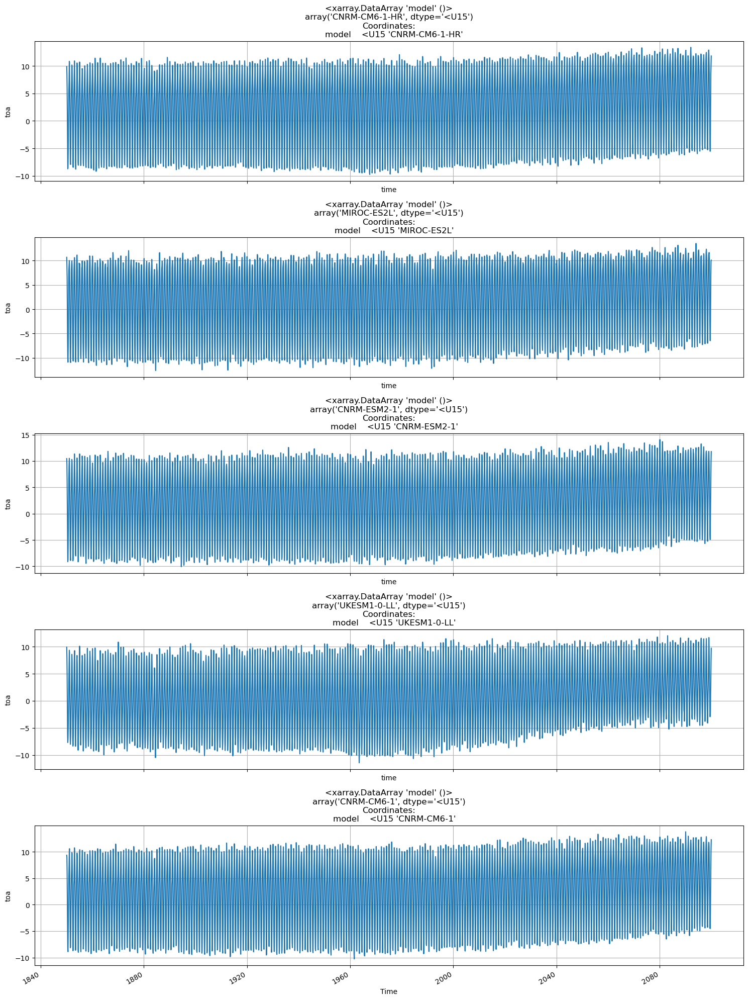

In [83]:
plot_time_series(0,5,20, ds_all_toa_models)

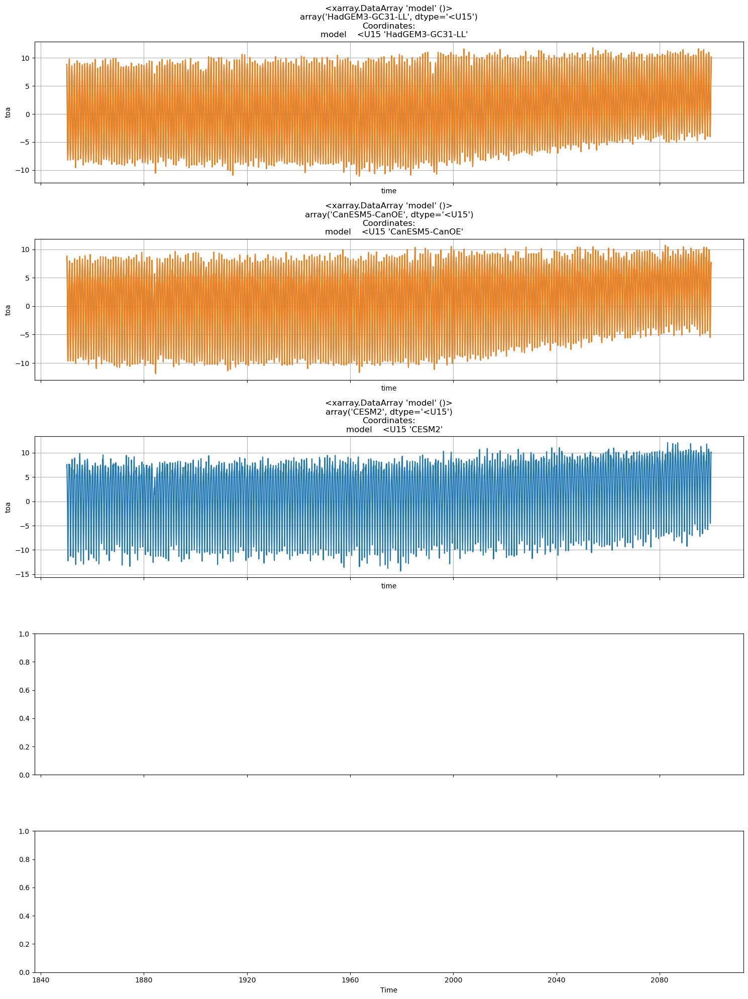

In [84]:
plot_time_series(0,5,25, ds_all_toa_models)

In [86]:
#general fn for makes these subplots
def plot_time_series_cre(fig_counter_input, num_subplots, model_index, dataset):
    fig, axs = plt.subplots(num_subplots, 1, figsize=(15, 20), sharex=True)
    fig_counter = fig_counter_input
    while fig_counter < (fig_counter_input + num_subplots): #made another while loop to separate the graphs and make it cleaner
        for i, model in enumerate(dataset.model[model_index:]): #sliced from 30th index after last model figure shown in previous cell block (index should be same each time in dataset)
            if fig_counter >= (fig_counter_input + num_subplots):
                break
            dataset.sel(model=model).cre.plot(ax=axs[i],label=model)
            axs[i].set_title(model) #shows what model number
            axs[i].set_ylabel('cre')
            axs[i].grid(True) #makes gridlines on plot
            fig_counter +=1
    axs[-1].set_xlabel('Time') 
    plt.tight_layout() #creates a better layout for subplots
    plt.show()

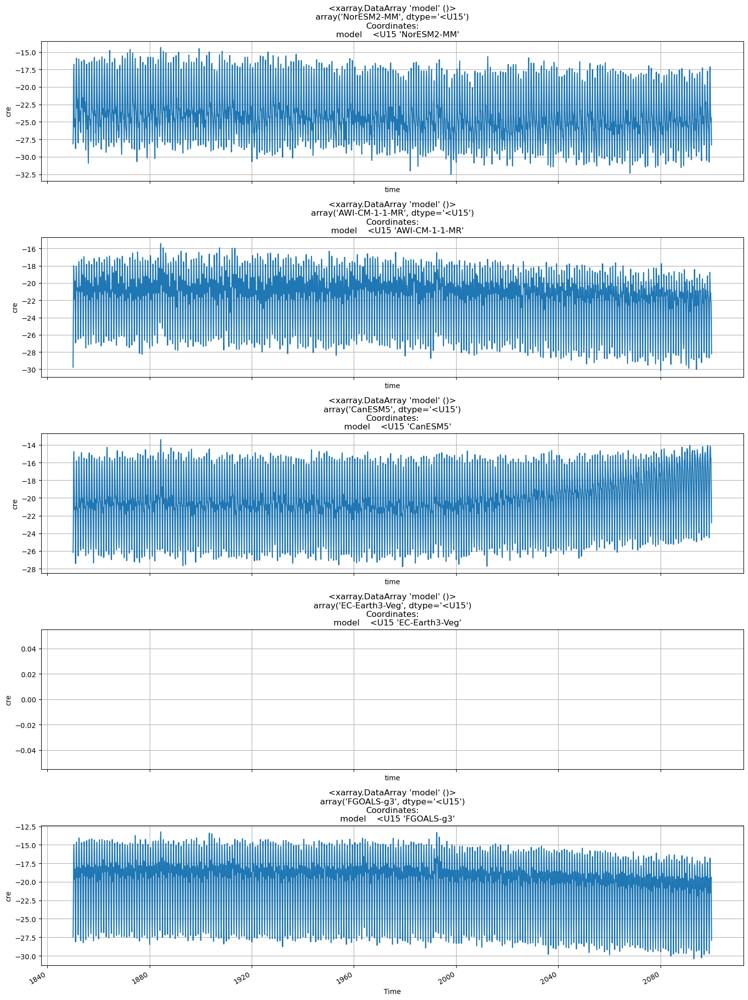

In [93]:
plot_time_series_cre(0,5,0, ds_all_toa_models)

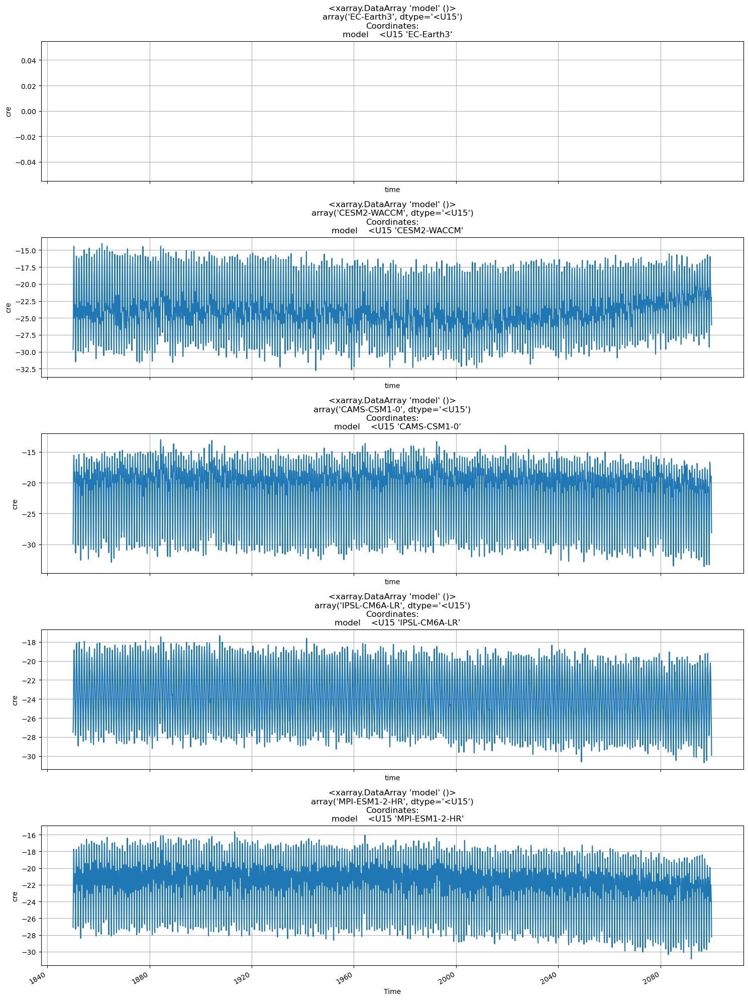

In [88]:
plot_time_series_cre(0,5,5, ds_all_toa_models)

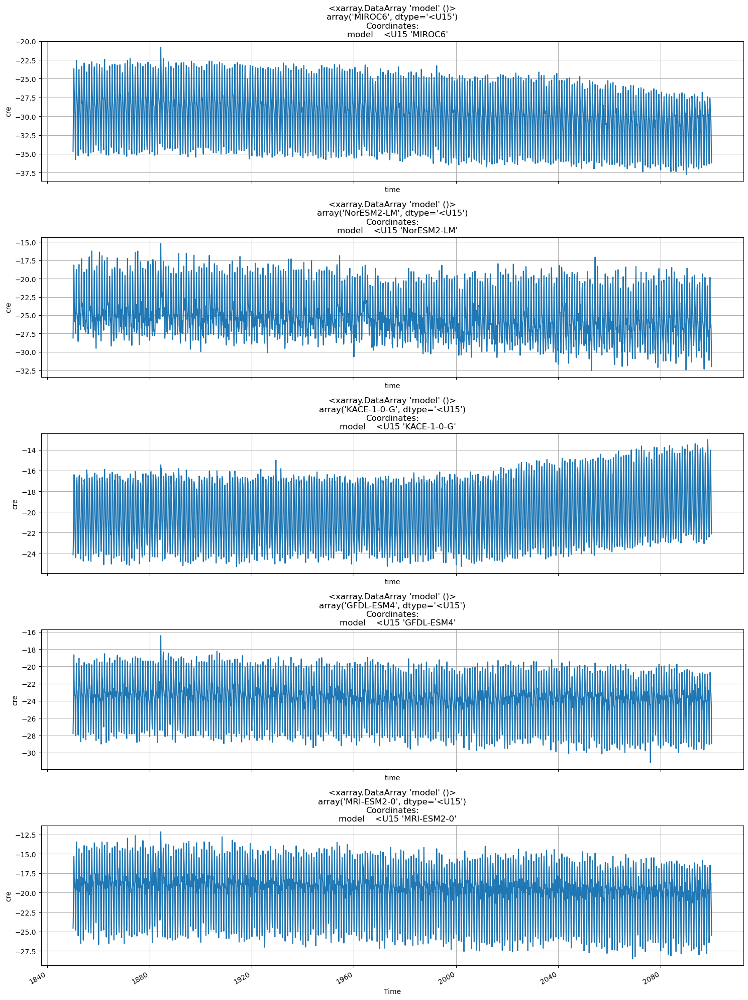

In [89]:
plot_time_series_cre(0,5,10, ds_all_toa_models)

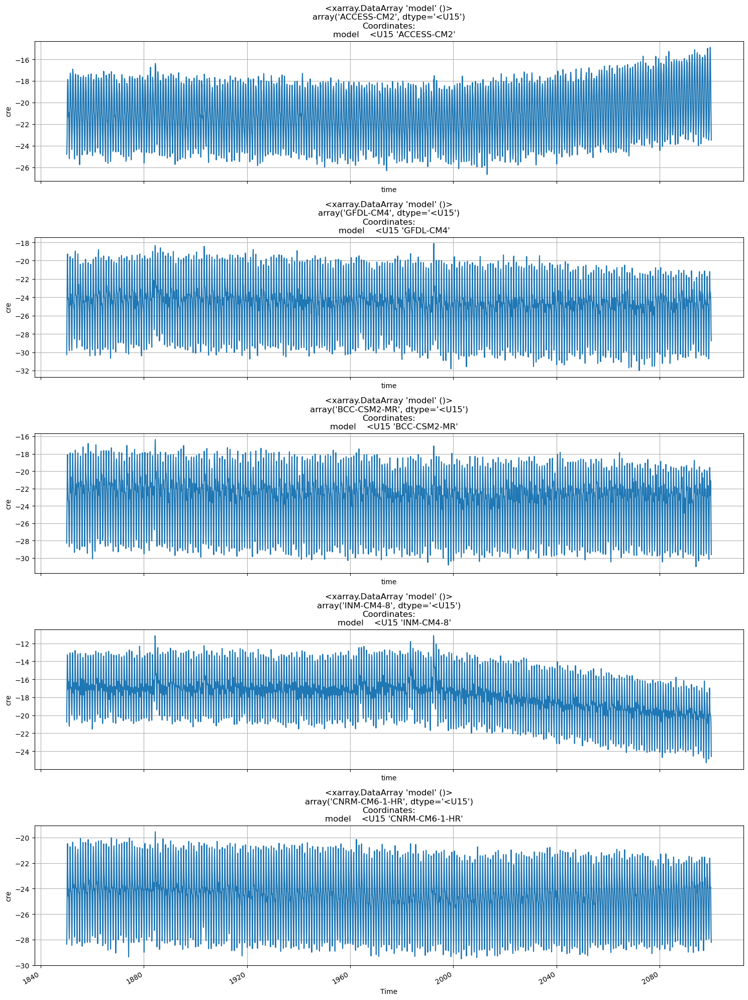

In [90]:
plot_time_series_cre(0,5,15, ds_all_toa_models)

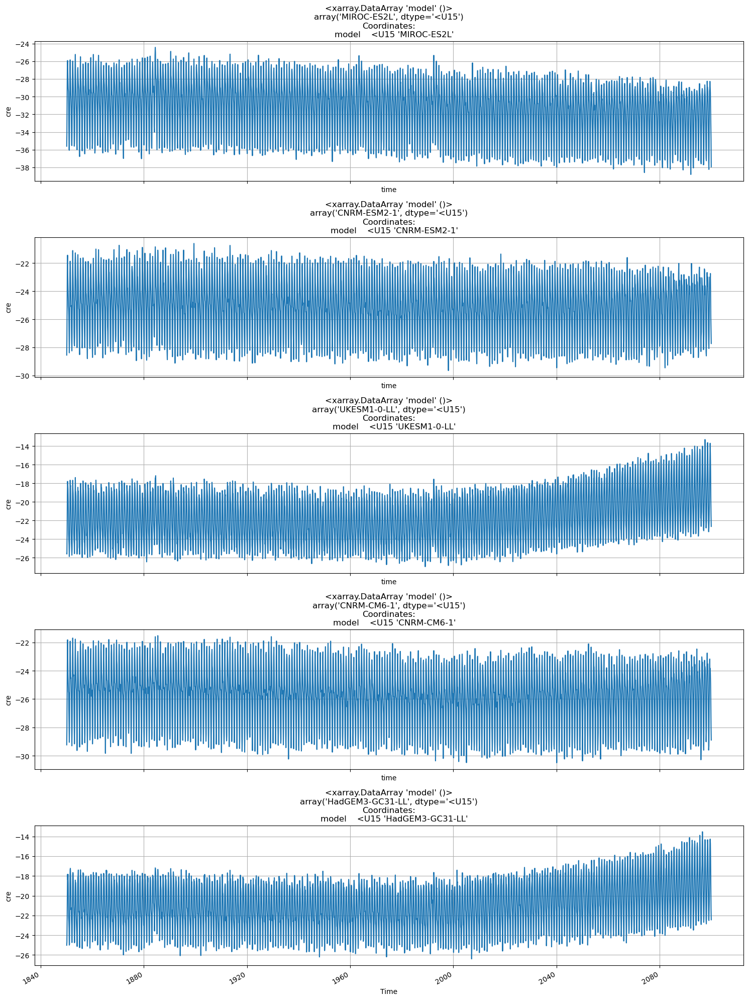

In [91]:
plot_time_series_cre(0,5,20, ds_all_toa_models)

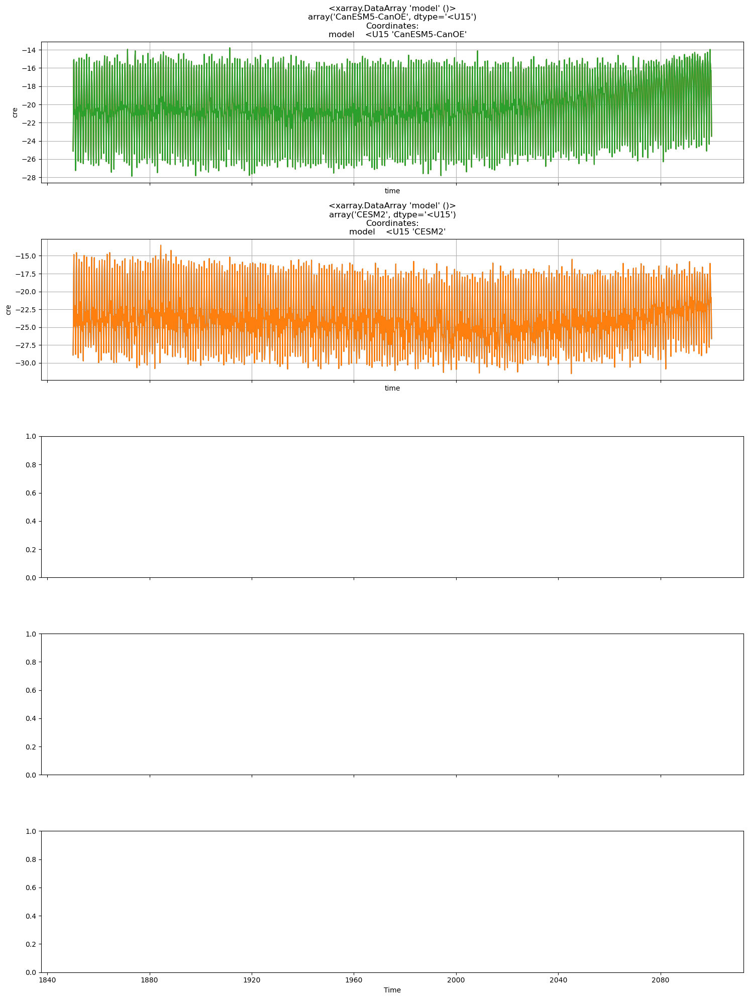

In [92]:
plot_time_series_cre(0,5,25, ds_all_toa_models)

#### Plots for tas

In [131]:
#general fn for makes these subplots
def plot_time_series_tas(fig_counter_input, num_subplots, model_index, dataset):
    fig, axs = plt.subplots(num_subplots, 1, figsize=(15, 20), sharex=True)
    fig_counter = fig_counter_input
    while fig_counter < (fig_counter_input + num_subplots): #made another while loop to separate the graphs and make it cleaner
        for i, model in enumerate(dataset.model[model_index:]): #sliced from 30th index after last model figure shown in previous cell block (index should be same each time in dataset)
            if fig_counter >= (fig_counter_input + num_subplots):
                break
            dataset.sel(model=model).tas.plot(ax=axs[i],label=model)
            axs[i].set_title(model) #shows what model number
            axs[i].set_ylabel('tas')
            axs[i].grid(True) #makes gridlines on plot
            fig_counter +=1
    axs[-1].set_xlabel('Time') 
    plt.tight_layout() #creates a better layout for subplots
    plt.show()

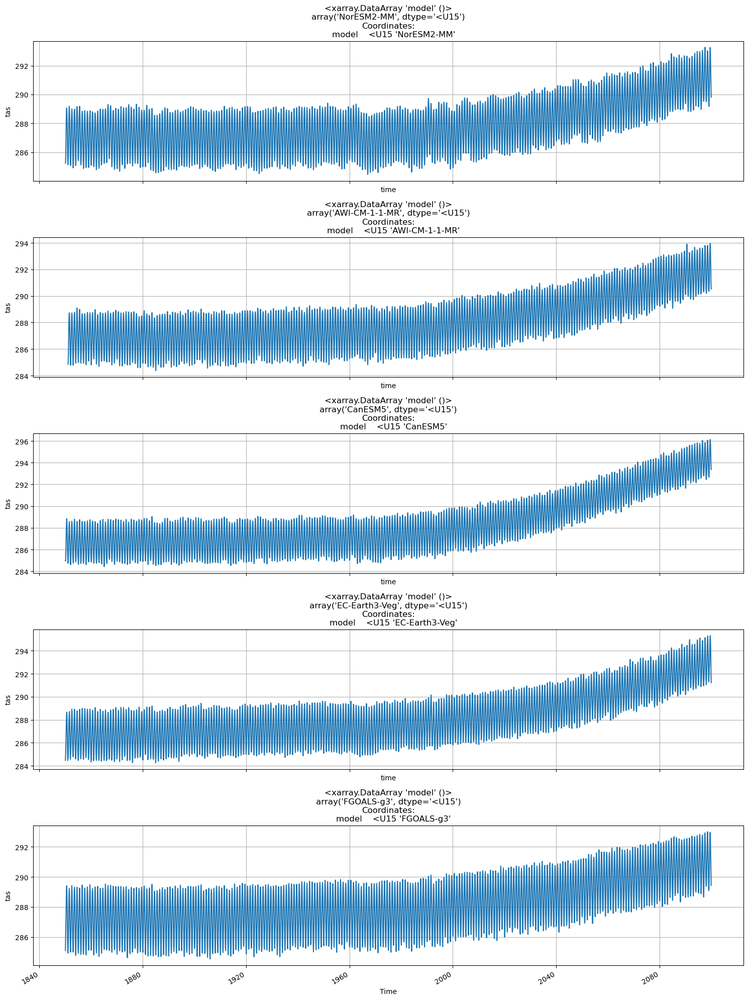

In [133]:
plot_time_series_tas(0,5,0,ds_all_toa_models)

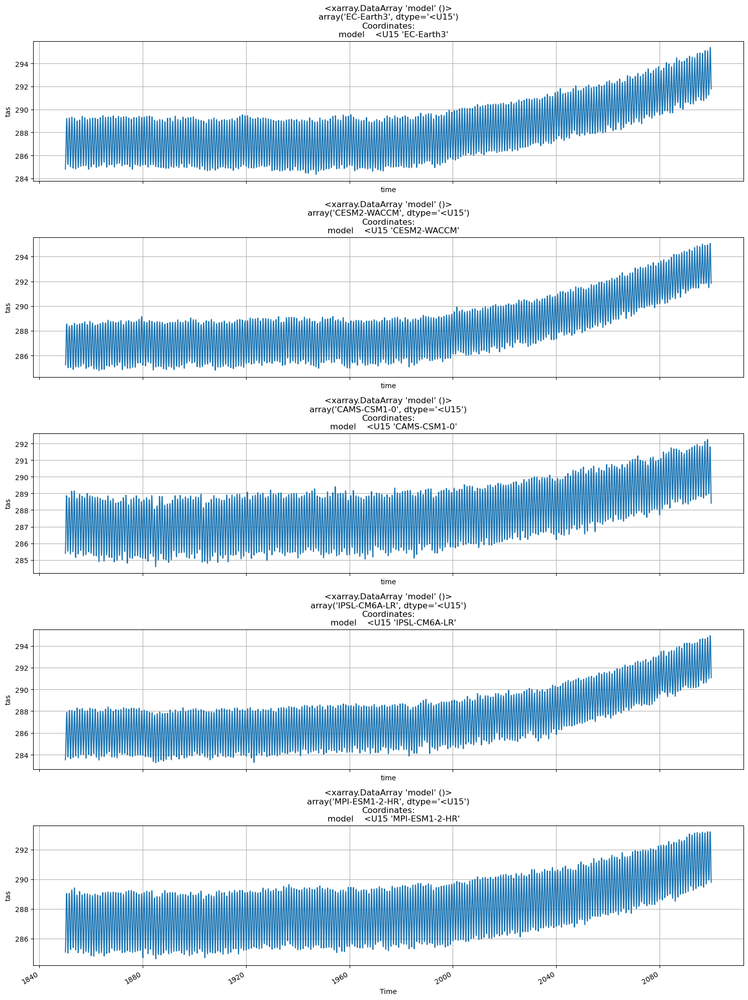

In [134]:
plot_time_series_tas(0,5,5,ds_all_toa_models)

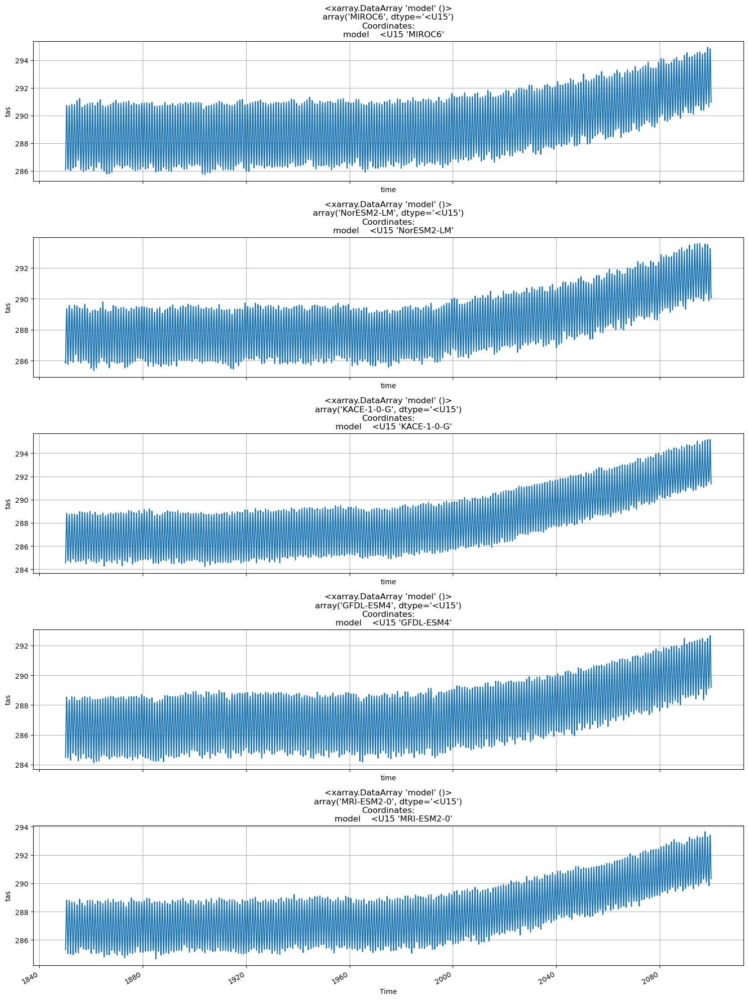

In [135]:
plot_time_series_tas(0,5,10,ds_all_toa_models)

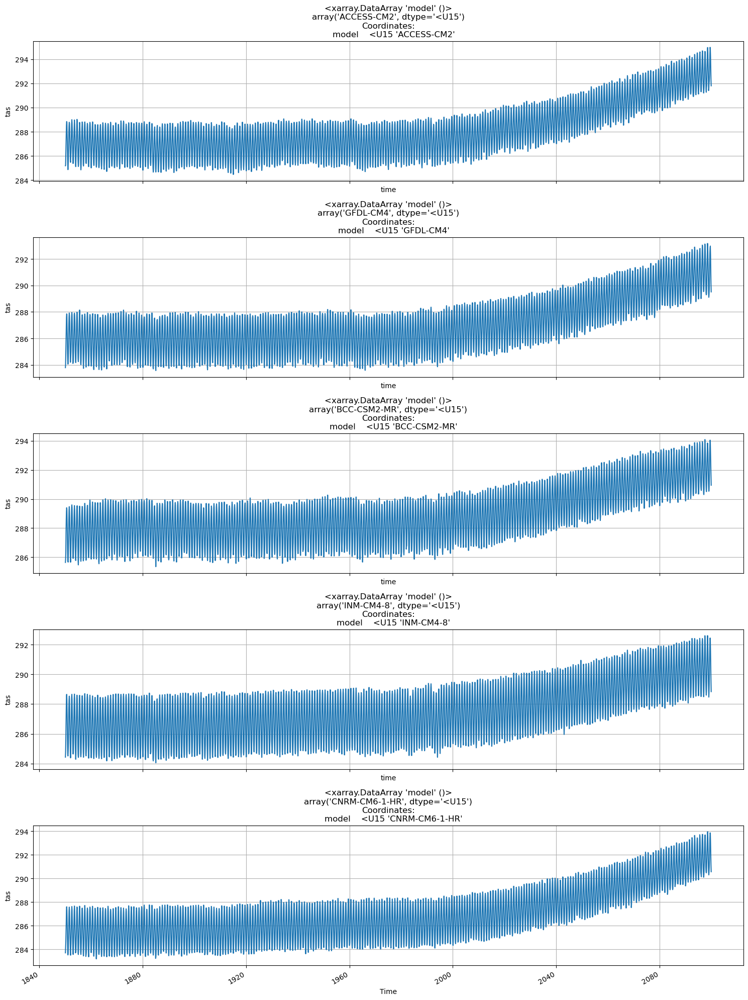

In [136]:
plot_time_series_tas(0,5,15,ds_all_toa_models)

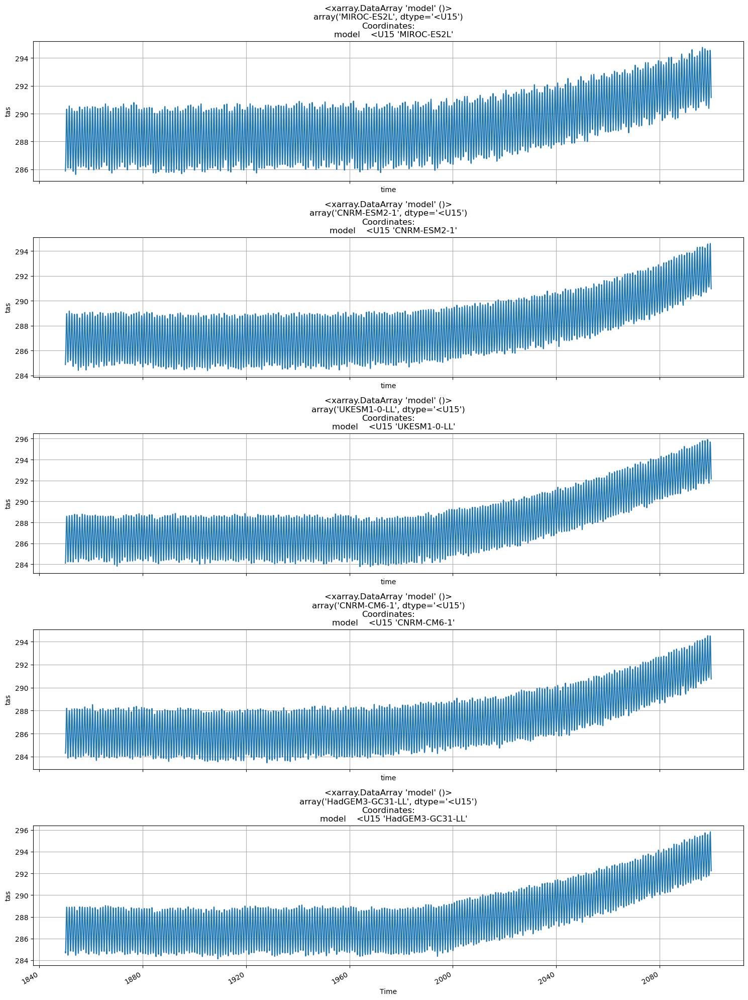

In [137]:
plot_time_series_tas(0,5,20,ds_all_toa_models)

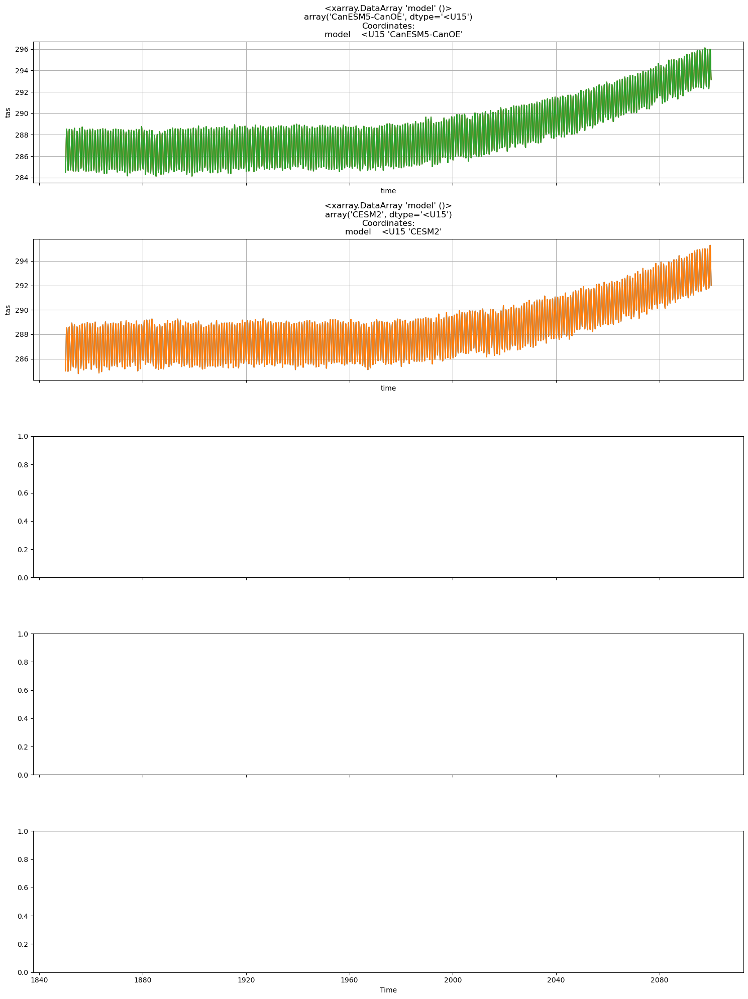

In [138]:
plot_time_series_tas(0,5,25,ds_all_toa_models)

### 1.3 Monthly Anomalies

In [50]:
#computing TAS anomalies
#remove seasonal cycle
ds_tas_anom = ds_all_toa_models.tas.groupby('time.month') - ds_all_toa_models.tas.groupby('time.month').mean('time')
ds_tas_anom = ds_tas_anom - ds_tas_anom.sel(time=slice('1850','1900')).mean('time')
ds_tas_anom

C:\Users\panda\miniconda3\envs\temp_var\Lib\site-packages\xarray\core\indexing.py:1443: PerformanceWarning: Slicing with an out-of-order index is generating 250 times more chunks
  return self.array[key]


<xarray.DataArray 'tas' (model: 27, time: 3000)>
dask.array<sub, shape=(27, 3000), dtype=float64, chunksize=(1, 1), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
  * model    (model) <U15 'MPI-ESM1-2-HR' 'KACE-1-0-G' ... 'CESM2'
    month    (time) int64 1 2 3 4 5 6 7 8 9 10 11 ... 2 3 4 5 6 7 8 9 10 11 12

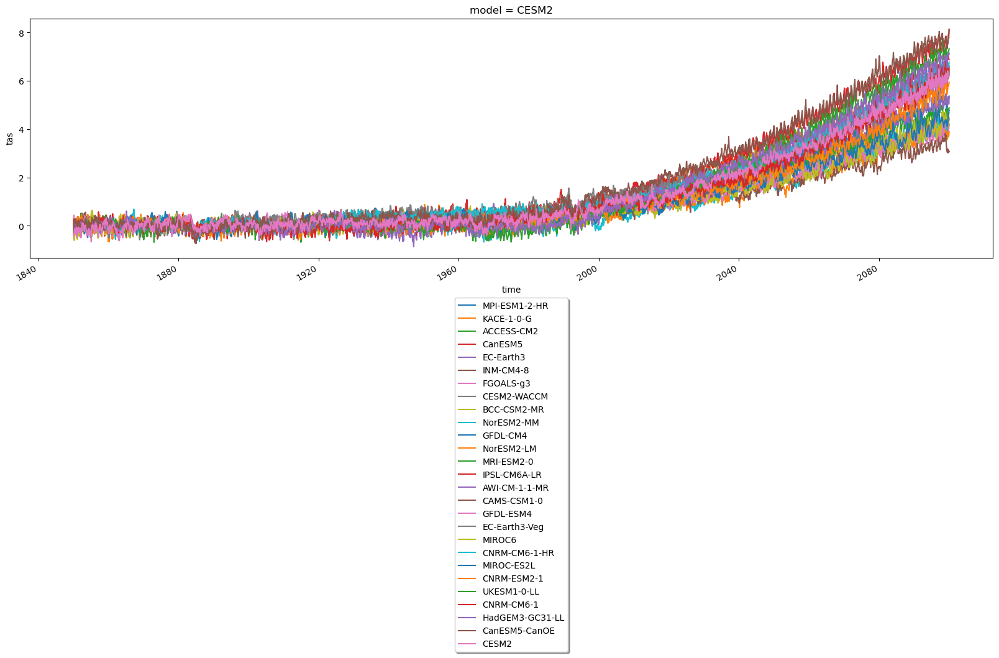

In [51]:
fig, ax = plt.subplots(figsize=(20,5))
# Plot each line separately and collect the lines and labels
handles = []
labels = []
for m in ds_tas_anom.model.values:
    line = ds_tas_anom.sel(model=m).plot.line(ax=ax, x='time', hue='model', add_legend=False)
    handles.append(Line2D([], [], color=line[0].get_color(), label=m))  # Create Line2D handle
    labels.append(m)
ax.legend(handles=handles, labels=labels, loc='upper center', bbox_to_anchor=(0.5, -0.15), fancybox=True, shadow=True)

In [52]:
#TOA anomalies
#remove seasonal cycle
ds_toa_anom = ds_all_toa_models.toa.groupby('time.month') - ds_all_toa_models.toa.groupby('time.month').mean('time')
#remove baseline: remove avg temp from 1850 to 1900
#ensure that what we are plotting are monthly anomalies relative to an 1850-1900 baseline
ds_toa_anom = ds_toa_anom - ds_toa_anom.sel(time=slice('1850','1900')).mean('time')
ds_toa_anom

C:\Users\panda\miniconda3\envs\temp_var\Lib\site-packages\xarray\core\indexing.py:1443: PerformanceWarning: Slicing with an out-of-order index is generating 250 times more chunks
  return self.array[key]


<xarray.DataArray 'toa' (model: 27, time: 3000)>
dask.array<sub, shape=(27, 3000), dtype=float64, chunksize=(1, 1), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
  * model    (model) <U15 'MPI-ESM1-2-HR' 'KACE-1-0-G' ... 'CESM2'
    month    (time) int64 1 2 3 4 5 6 7 8 9 10 11 ... 2 3 4 5 6 7 8 9 10 11 12

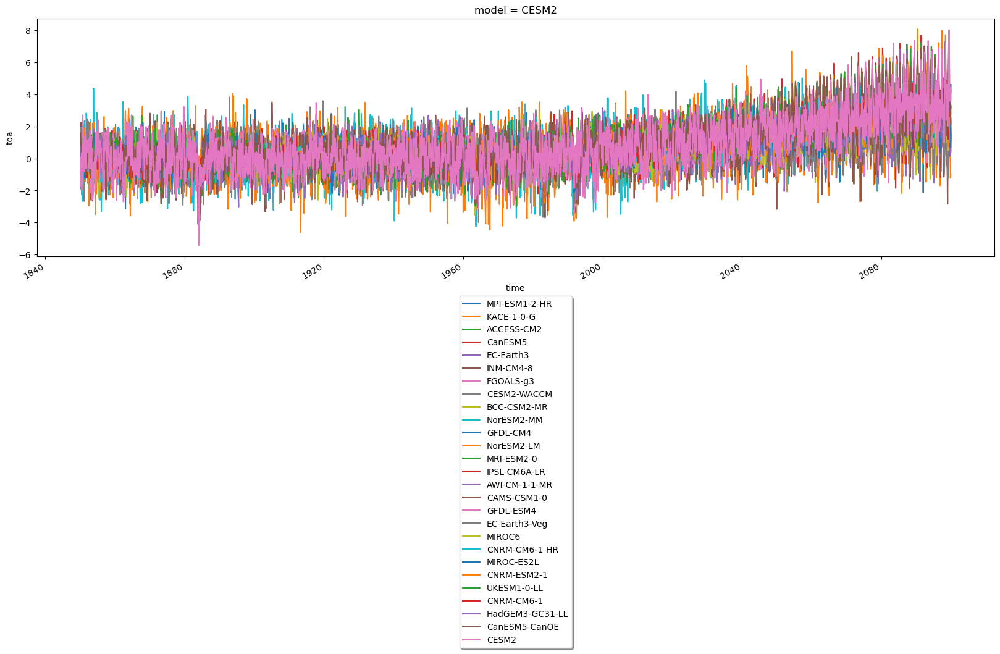

In [53]:
fig, ax = plt.subplots(figsize=(20,5))
# Plot each line separately and collect the lines and labels
handles = []
labels = []
for m in ds_toa_anom.model.values:
    line = ds_toa_anom.sel(model=m).plot.line(ax=ax, x='time', hue='model', add_legend=False)
    handles.append(Line2D([], [], color=line[0].get_color(), label=m))  # Create Line2D handle
    labels.append(m)
ax.legend(handles=handles, labels=labels, loc='upper center', bbox_to_anchor=(0.5, -0.15), fancybox=True, shadow=True)

In [54]:
#CRE anomalies
#remove seasonal cycle
ds_cre_anom = ds_all_toa_models.cre.groupby('time.month') - ds_all_toa_models.cre.groupby('time.month').mean('time')
#remove baseline: remove avg temp from 1850 to 1900
#ensure that what we are plotting are monthly anomalies relative to an 1850-1900 baseline
ds_cre_anom = ds_cre_anom - ds_cre_anom.sel(time=slice('1850','1900')).mean('time')
ds_cre_anom

C:\Users\panda\miniconda3\envs\temp_var\Lib\site-packages\xarray\core\indexing.py:1443: PerformanceWarning: Slicing with an out-of-order index is generating 250 times more chunks
  return self.array[key]


<xarray.DataArray 'cre' (model: 27, time: 3000)>
dask.array<sub, shape=(27, 3000), dtype=float64, chunksize=(1, 1), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) datetime64[ns] 1850-01-31 1850-02-28 ... 2099-12-31
  * model    (model) <U15 'MPI-ESM1-2-HR' 'KACE-1-0-G' ... 'CESM2'
    month    (time) int64 1 2 3 4 5 6 7 8 9 10 11 ... 2 3 4 5 6 7 8 9 10 11 12

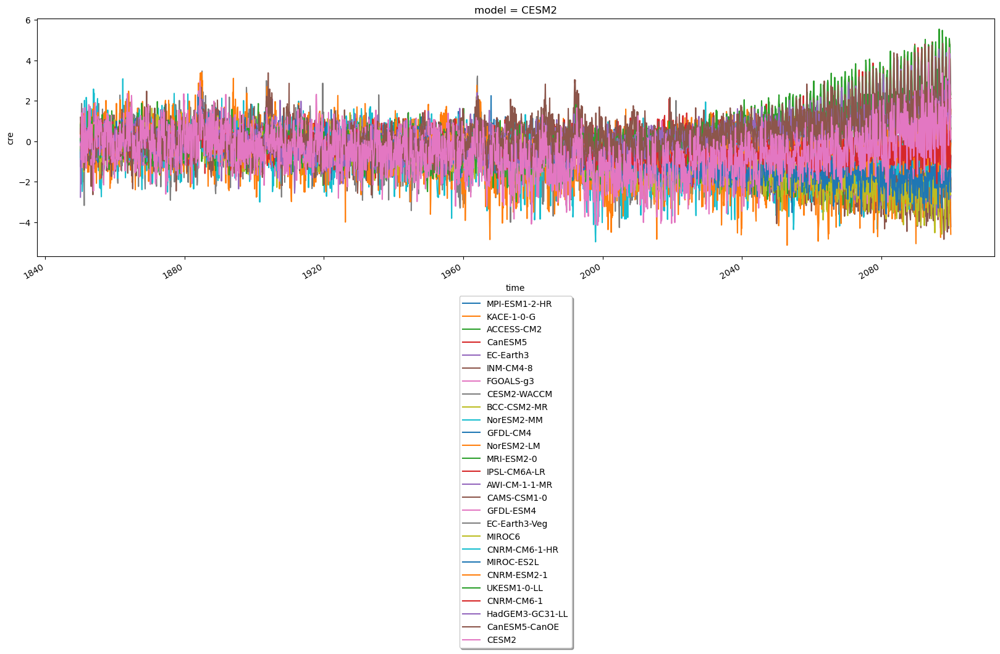

In [55]:
fig, ax = plt.subplots(figsize=(20,5))
# Plot each line separately and collect the lines and labels
handles = []
labels = []
for m in ds_cre_anom.model.values:
    line = ds_cre_anom.sel(model=m).plot.line(ax=ax, x='time', hue='model', add_legend=False)
    handles.append(Line2D([], [], color=line[0].get_color(), label=m))  # Create Line2D handle
    labels.append(m)
ax.legend(handles=handles, labels=labels, loc='upper center', bbox_to_anchor=(0.5, -0.15), fancybox=True, shadow=True)

In [56]:
ds_all_toa_models.to_netcdf("CMIP6_processed_global_TOA_ssp585_data_2025-04-07.nc", mode = 'w', format = "NETCDF4", engine = 'netcdf4')